# Fireworks Galaxy Observation

#### In this notebok, I will be exploring feature exploration using the help of filters and image manipulation to uncover more details from a particular feature of the same image.

## Importing Important Libraries

In [1]:
#GENERAL
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.cm as mtpltcm
from mpl_toolkits.mplot3d import Axes3D
import random
import time

In [ ]:
import os
import os.path
from pathlib import Path
import glob
from scipy.io import loadmat
import nibabel as nib
import csv
from astropy.visualization import astropy_mpl_style
from astropy.utils.data import get_pkg_data_filename
from astropy.io import fits
import astropy
from astropy import units as u 
import astropy.wcs as fitswcs
#from specutils import Spectrum1D, SpectralRegion
from astropy.cosmology import WMAP9 as Cosmology

In [ ]:
from PIL import Image
from keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2
from keras.applications.vgg16 import preprocess_input, decode_predictions
from keras.preprocessing import image
from skimage.feature import hessian_matrix, hessian_matrix_eigvals
from scipy.ndimage.filters import convolve
from skimage import data, io, filters
import skimage.morphology as morph
import skimage.exposure as skie
import skimage
from skimage.morphology import convex_hull_image, erosion
from IPython import display
from scipy.ndimage import gaussian_filter
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import matplotlib.patches as patches

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from keras.utils.np_utils import to_categorical
from sklearn.model_selection import train_test_split
from keras import regularizers
from sklearn.preprocessing import LabelEncoder
import sklearn

In [ ]:
from scipy.io.wavfile import read, write
import librosa
import librosa.display
import IPython
from IPython.display import Audio
import scipy
from scipy import signal
from scipy.fft import fftshift

In [ ]:
from warnings import filterwarnings
filterwarnings("ignore",category=DeprecationWarning)
filterwarnings("ignore", category=FutureWarning) 
filterwarnings("ignore", category=UserWarning)
filterwarnings("ignore", category=RuntimeWarning)

#### **Mount Drive and Read the data**

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
!unzip /content/gdrive/MyDrive/GALAXIES_CENTER.zip
NEAR_INFRARED_PATH = "/content/NGC6946/NEAR_INFRARED/n4k48nbsq_cal.fits"
HST_OPTICAL_PATH = "/content/NGC6946/OPTICAL/HST/idk404050/idk404050_drc.fits"
XMM_NEWTON_PATH = "/content/NGC6946/XMM_NEWTON_Soft_Xray/P0200670301EPX0003COLIM8000.FTZ"
XMM_OM_PATH = "/content/NGC6946/XMM_OM_Optical/P0200670301OMX000LSIMAGB000.FTZ"
ISO_PATH = "/content/NGC6946/ISO/csp3390040401.fits"

Mounted at /content/gdrive
Archive:  /content/gdrive/MyDrive/GALAXIES_CENTER.zip
  inflating: M100/ISO/csli23500615.fits  
  inflating: M100/NEAR_INFRARED/idkv31030_drz.fits  
  inflating: M100/OPTICAL/hst_05195_01_wfpc2_f702w_pc_drz.fits  
  inflating: M100/XMM_Newton_Soft_Xray/P0106860201EPX0003COLIM8000.FTZ  
  inflating: M100/XMM_OM_Optical/P0106860201OMX000USIMAGU000.FTZ  
  inflating: M101/ISO/csli26902583.fits  
  inflating: M101/NEAR_INFRARED/hst_11080_a6_nic_nic3_f187n_drz.fits  
  inflating: M101/OPTICAL/hst_13361_03_wfc3_uvis_f502n_drz.fits  
  inflating: M101/XMM_Newton_Soft_Xray/P0164560701EPX0003COLIM8000.FTZ  
  inflating: M101/XMM_OM_Optical/P0212480201OMX000USIMAGU000.FTZ  
  inflating: M31/ISO/csp4000162201.fits  
  inflating: M31/NEAR_INFRARED/hst_7919_13_nic_nic3_f160w_drz.fits  
  inflating: M31/OPTICAL/hst_05464_02_wfpc2_f814w_pc_drz.fits  
  inflating: M31/XMM_NEWTON_Soft_Xray/P0112570401EPX0003COLIM8000.FTZ  
  inflating: M31/XMM_OM_Optical/P0112570601OMX000USIM

#### Reading the individual Astronomical Instrument's data

In [ ]:
NI_OPEN = fits.open(NEAR_INFRARED_PATH)
HST_OPEN = fits.open(HST_OPTICAL_PATH)
XMM_NEWTON_OPEN = fits.open(XMM_NEWTON_PATH)
XMM_OM_OPEN = fits.open(XMM_OM_PATH)
ISO_OPEN = fits.open(ISO_PATH)

In [ ]:
HST_SCI = HST_OPEN[1].data

#### Slicing the images to obtain a specific scale/zoom and centering on a feature. 

This is a trial and error step, as most of these images are fairly huge for any desktop screen, viewing different slices can help triangulate on a feuture of interest.

In [ ]:
WIDE_SCALE_HST = HST_SCI[700:4000,700:4000]
ZOOMED_SCALE_HST = HST_SCI[1800:3400,1700:3200]
ZOOMED_X2_SCALE_HST = HST_SCI[2100:3100,2000:3000]
ZOOMED_X3_SCALE_HST = HST_SCI[2450:2850,2300:2700]
NUCLEUS_SCALE_HST = HST_SCI[2640:2850,2330:2650]

#### Applying the following filters with the list of spectral maps on the sliced features:
* SATO filter
* Meijering filter with Black ridges
* Meijering filter with White ridges
* Roberts' Cross Operator filter with Negative Diagonal
* Förstner corner detector filter 

#### 4. Förstner corner detector filter
Corner detection is an approach used within computer vision systems to extract certain kinds of features and infer the contents of an image. To compute the location of a corner with subpixel accuracy, the Förstner algorithm solves for the point closest to all the tangent lines of the corner in a given window and is a least-square solution. The algorithm relies on the fact that for an ideal corner, tangent lines cross at a single point.

```
skimage.feature.corner_foerstner(image, sigma=1)
```

#### Parameters:
```
image(M, N) ndarray
Input image.

sigmafloat, optional
Standard deviation used for the Gaussian kernel, which is used as weighting function for the auto-correlation matrix.
```
#### Returns:
```
wndarray
Error ellipse sizes.

qndarray
Roundness of error ellipse.
```

In [ ]:
# Applying SATO
SATO_ZOOMED_X3_SCALE_HST = filters.sato(ZOOMED_X3_SCALE_HST)
SATO_NUCLEUS_SCALE_HST = filters.sato(NUCLEUS_SCALE_HST)

In [ ]:
# Applying Meijering filter with Black ridges
M_ZOOMED_X3_SCALE_HST = filters.meijering(ZOOMED_X3_SCALE_HST)
M_NUCLEUS_SCALE_HST = filters.meijering(NUCLEUS_SCALE_HST)

In [ ]:
# Applying Meijering filter with White ridges
BM_ZOOMED_X3_SCALE_HST = filters.meijering(ZOOMED_X3_SCALE_HST,black_ridges=False)
BM_NUCLEUS_SCALE_HST = filters.meijering(NUCLEUS_SCALE_HST,black_ridges=False)

In [ ]:
# Applying Roberts' Cross Operator filter with Negative Diagonal
R_ZOOMED_X3_SCALE_HST = filters.roberts_neg_diag(ZOOMED_X3_SCALE_HST)
R_NUCLEUS_SCALE_HST = filters.roberts_neg_diag(NUCLEUS_SCALE_HST)

In [ ]:
#Applying Förstner corner detector filter
FCF_ZOOMED_X3_SCALE_HST = skimage.feature.corner_foerstner(ZOOMED_X3_SCALE_HST)
FCF_NUCLEUS_SCALE_HST = skimage.feature.corner_foerstner(NUCLEUS_SCALE_HST)

#### Populating a list with all the required Spectral maps

In [ ]:
SPECTRAL_LIST = ["gray","jet","hot","prism","nipy_spectral","gist_ncar","gist_earth","gist_stern","flag","gnuplot2",'terrain']

#### Visualizing the SATO filter on the Nucleus of the image in normal and 3x zoom

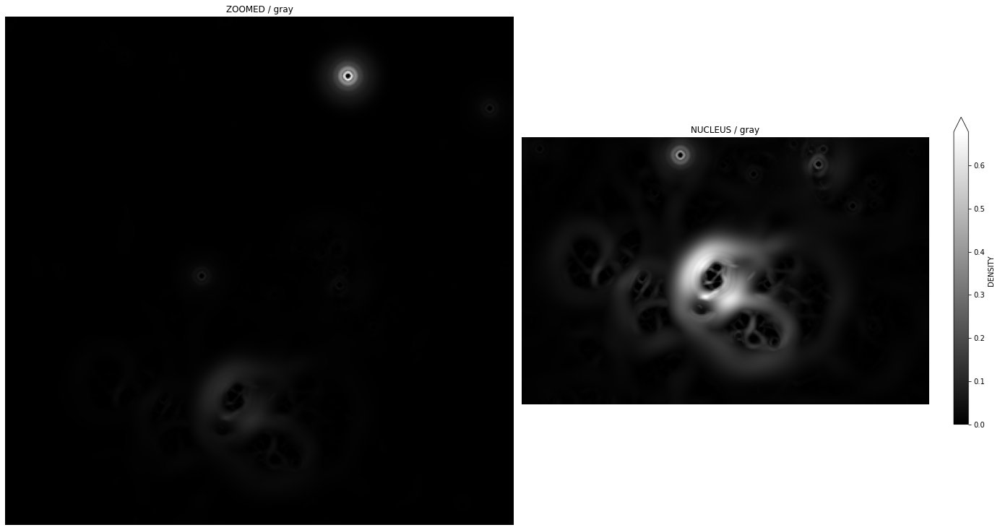

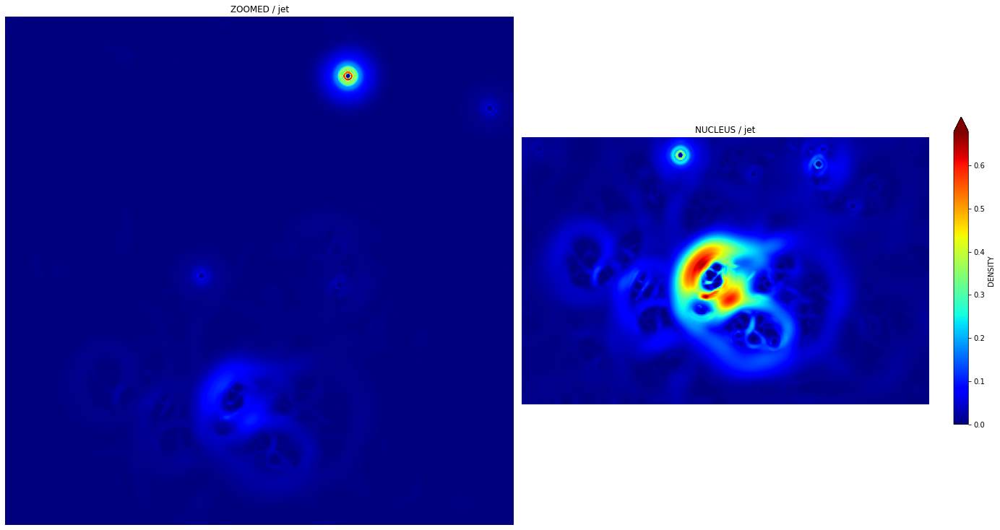

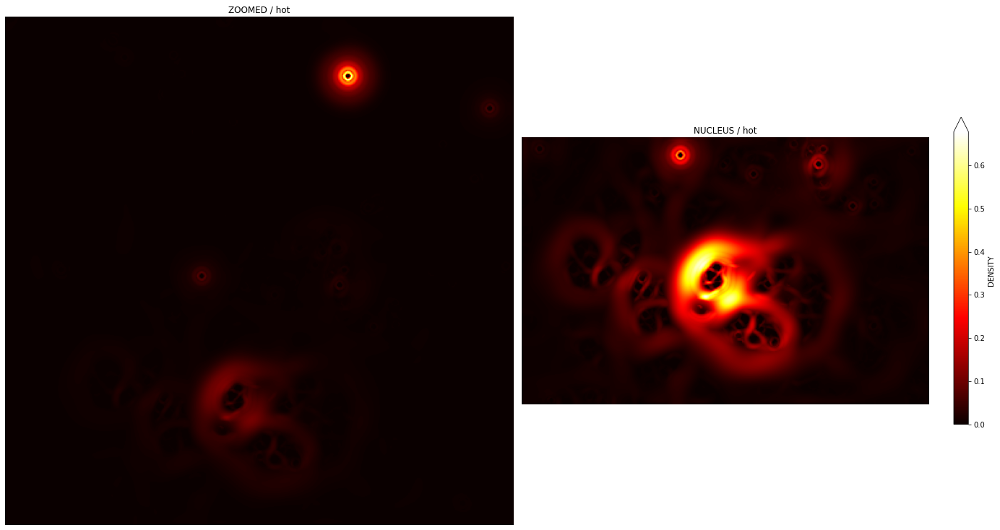

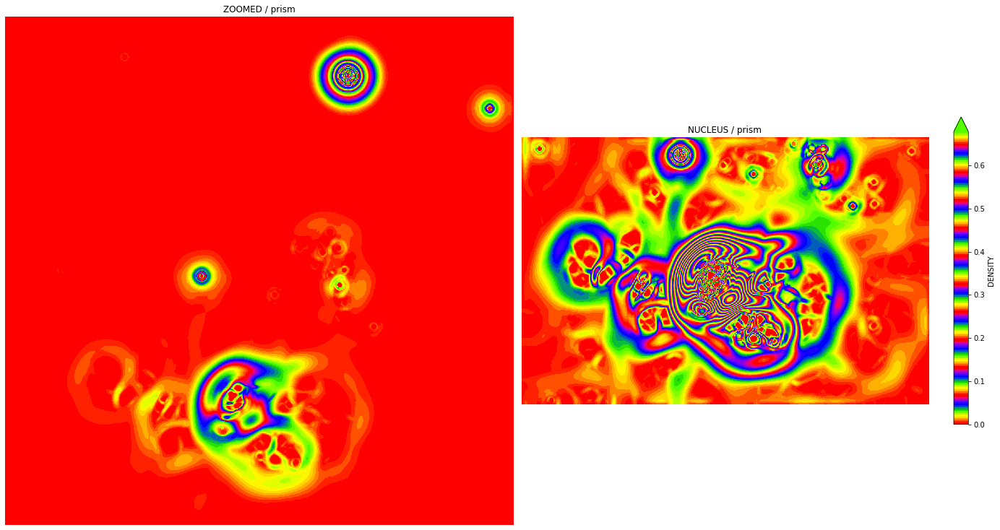

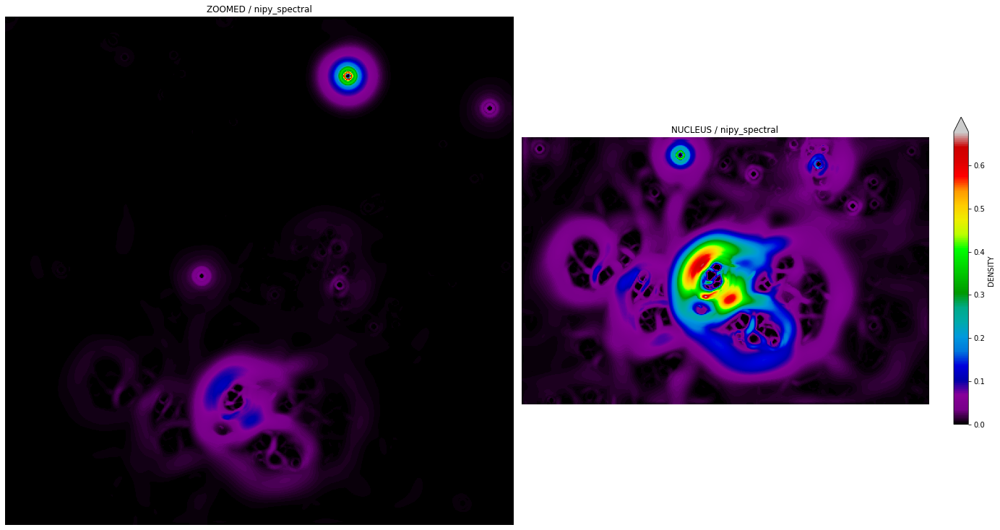

...

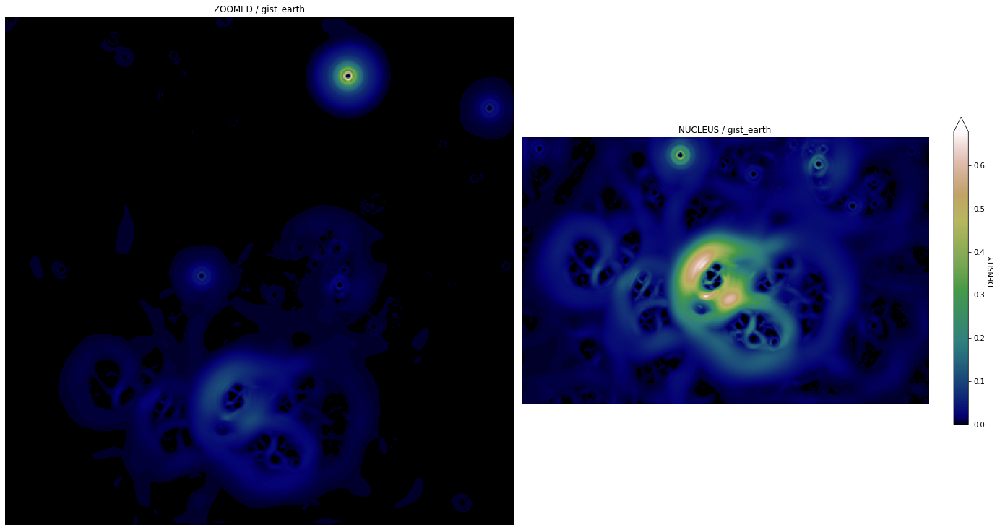

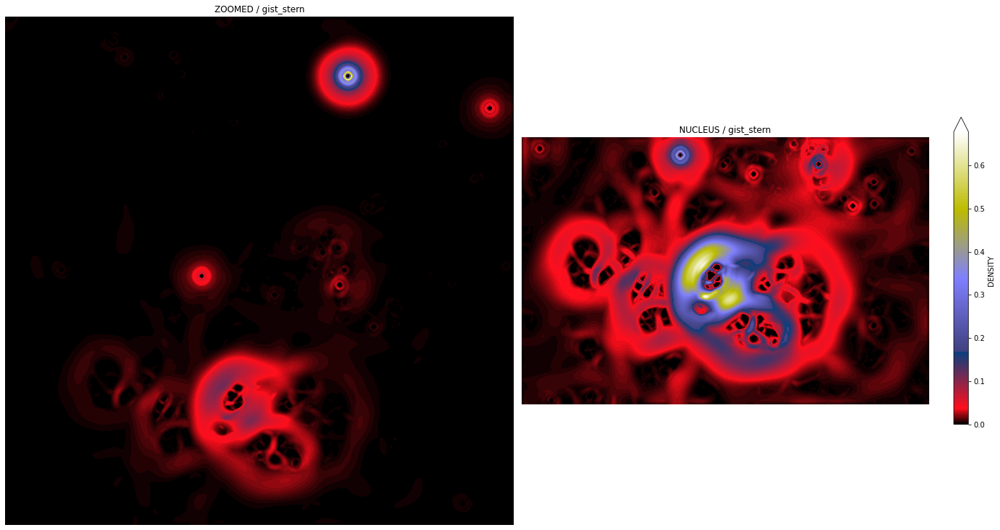

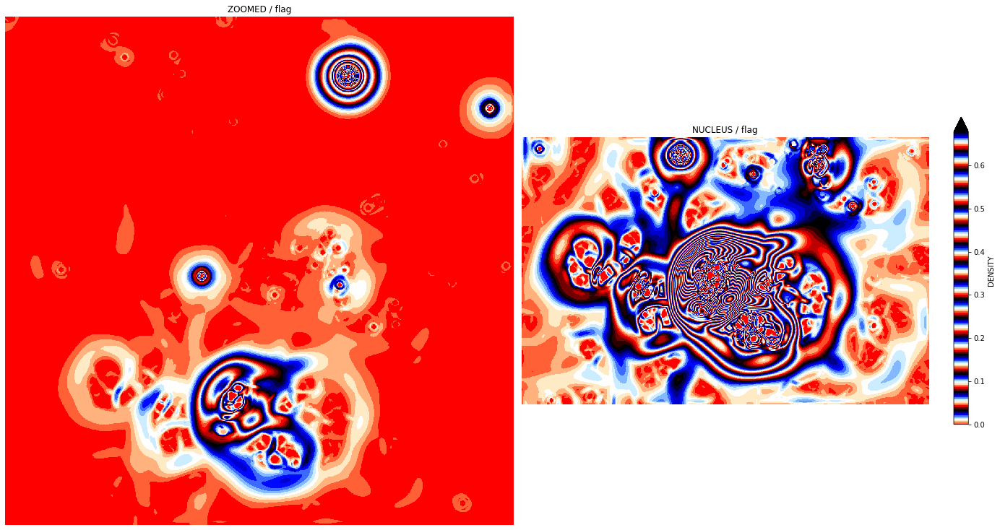

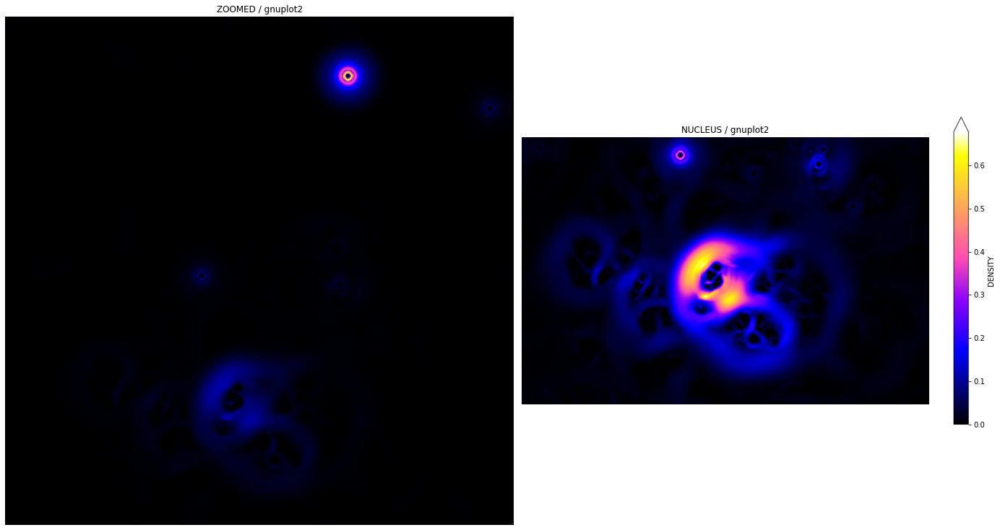

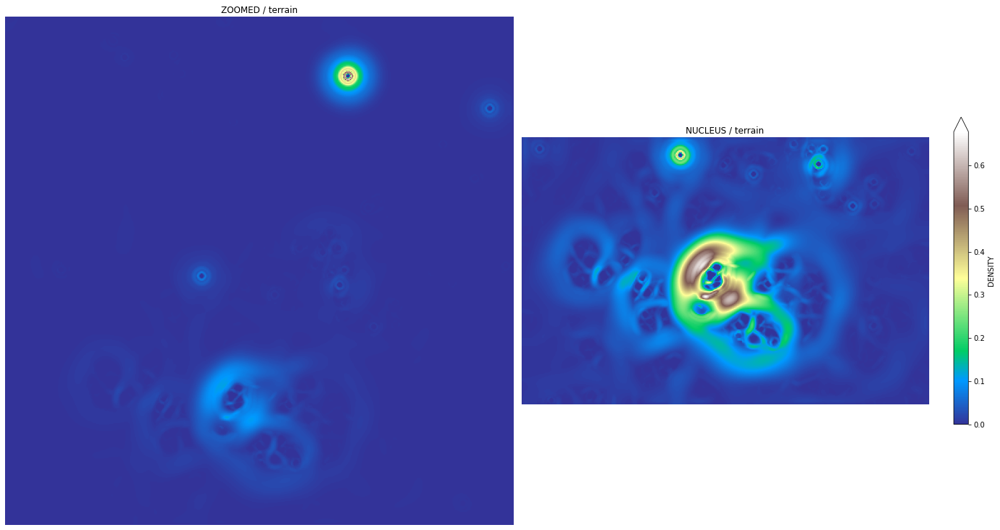

In [ ]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,2,figsize=(20,20))
    
    axis[0].imshow(SATO_ZOOMED_X3_SCALE_HST,cmap=x_spec)
    axis[0].set_title("ZOOMED" + " / "+ x_spec)
    axis[0].axis("off")
    
    DENSITY_FUNC = axis[1].imshow(SATO_NUCLEUS_SCALE_HST,cmap=x_spec)
    axis[1].set_title("NUCLEUS" + " / "+ x_spec)
    axis[1].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

#### Visualizing the Meijering filter with Black ridges on the Nucleus of the image in normal and 3x zoom

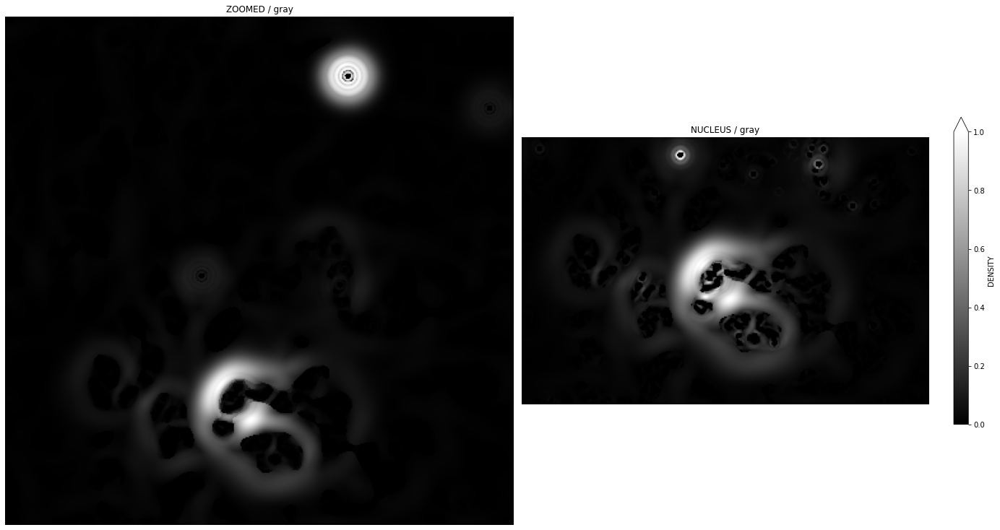

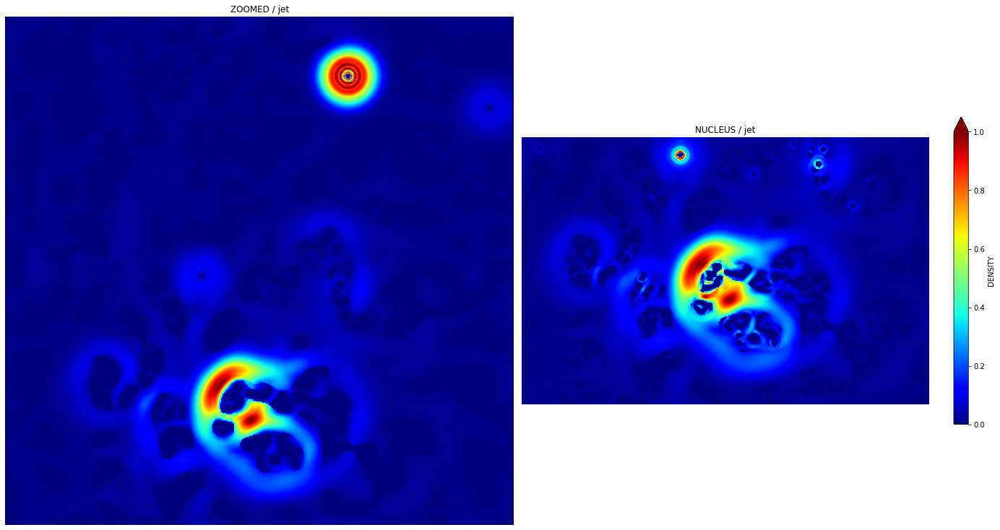

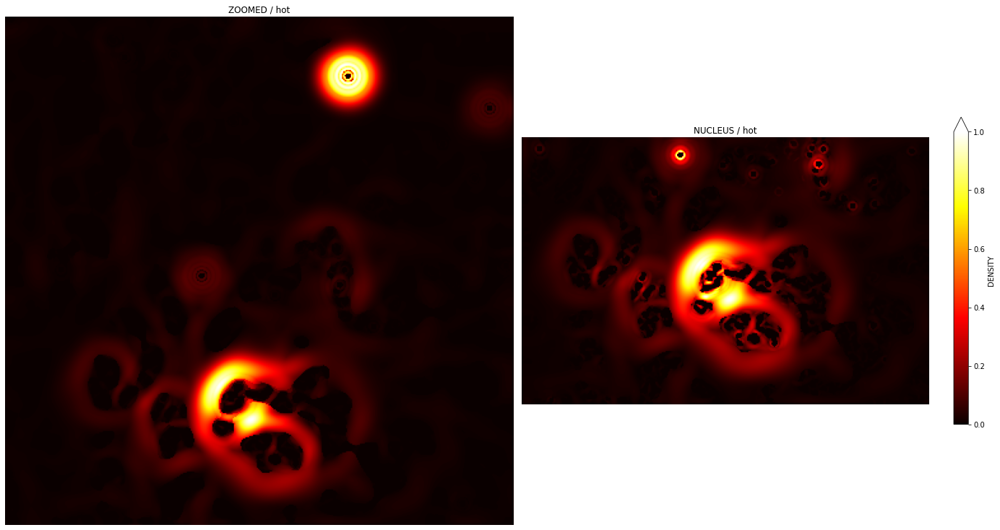

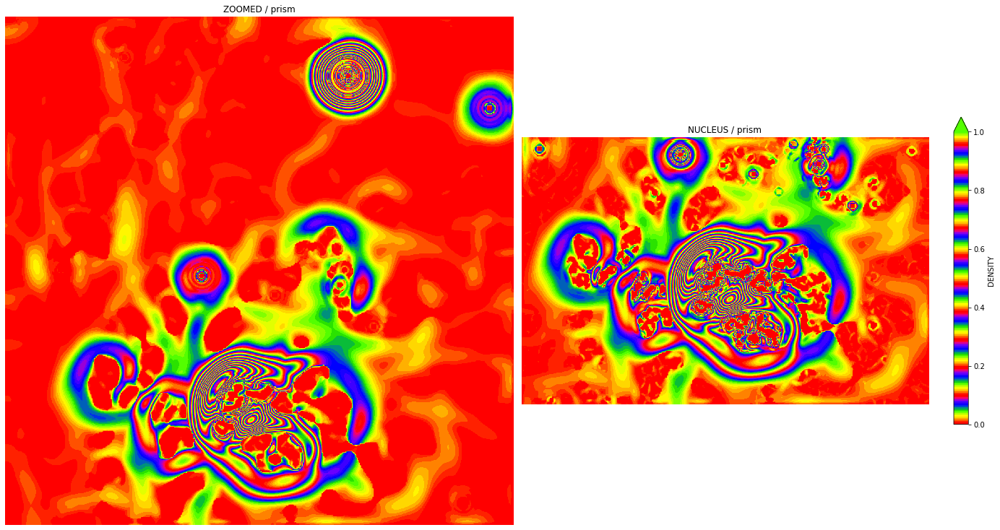

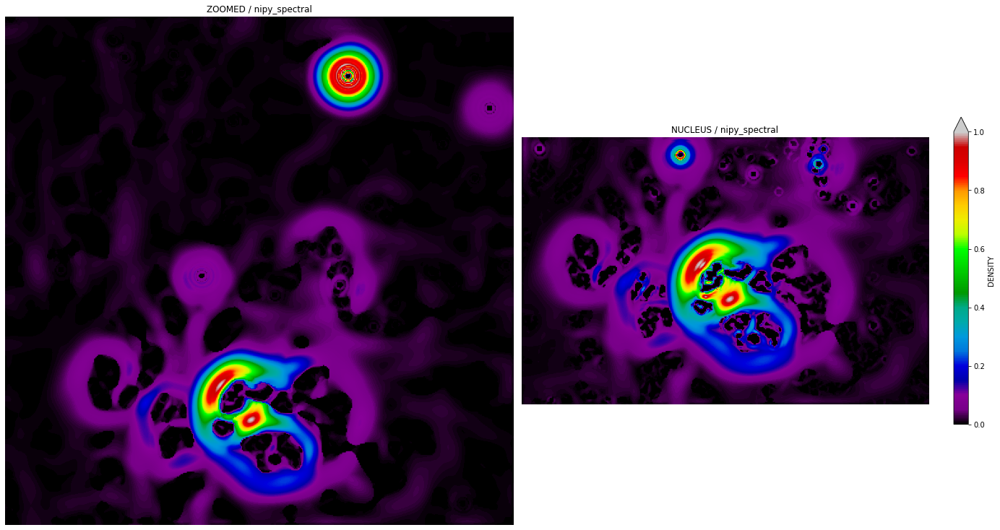

...

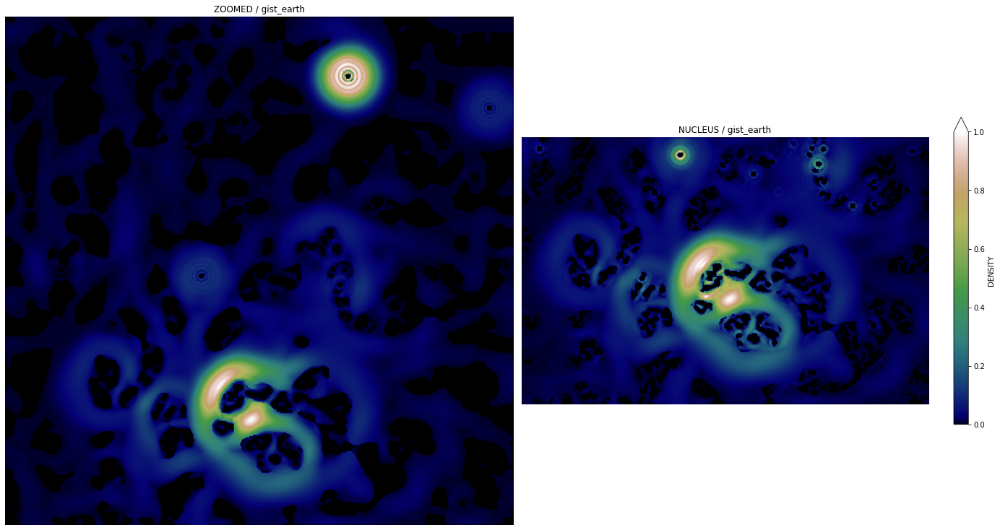

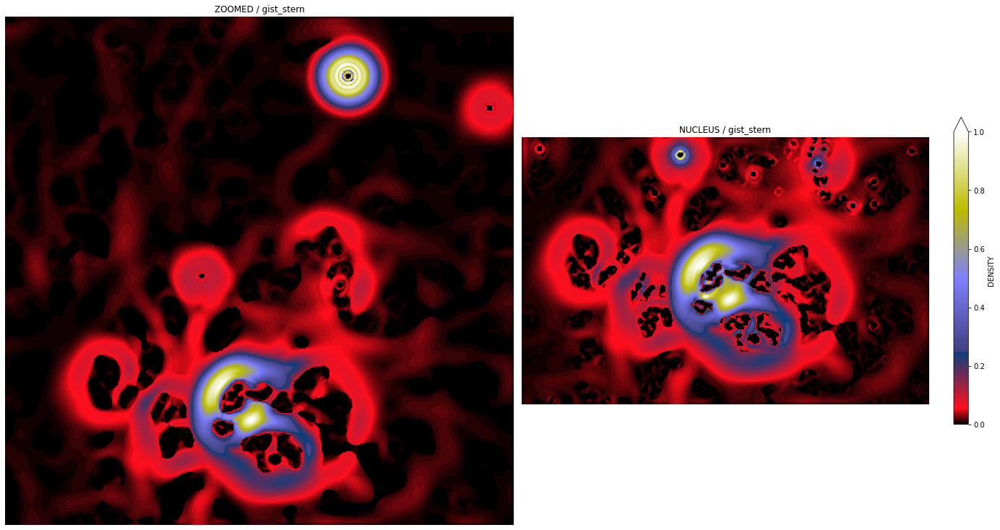

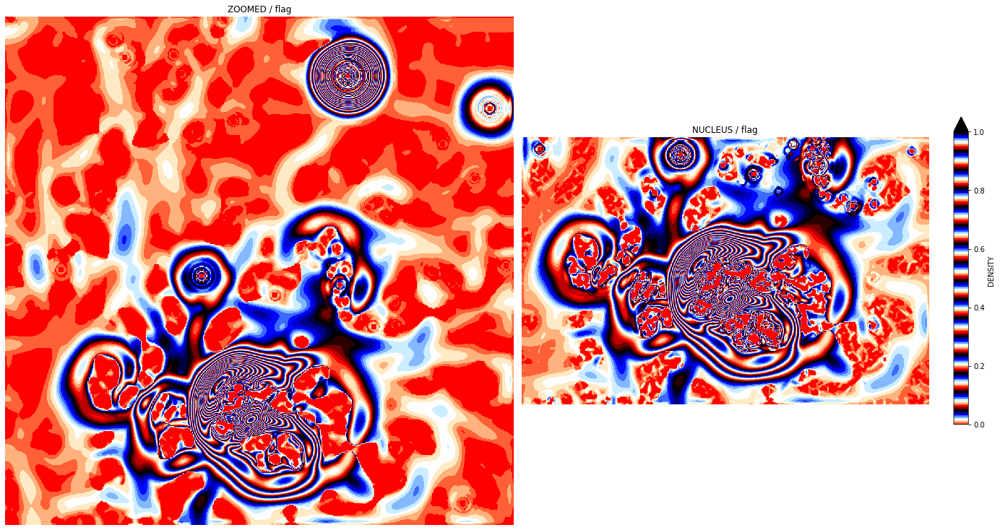

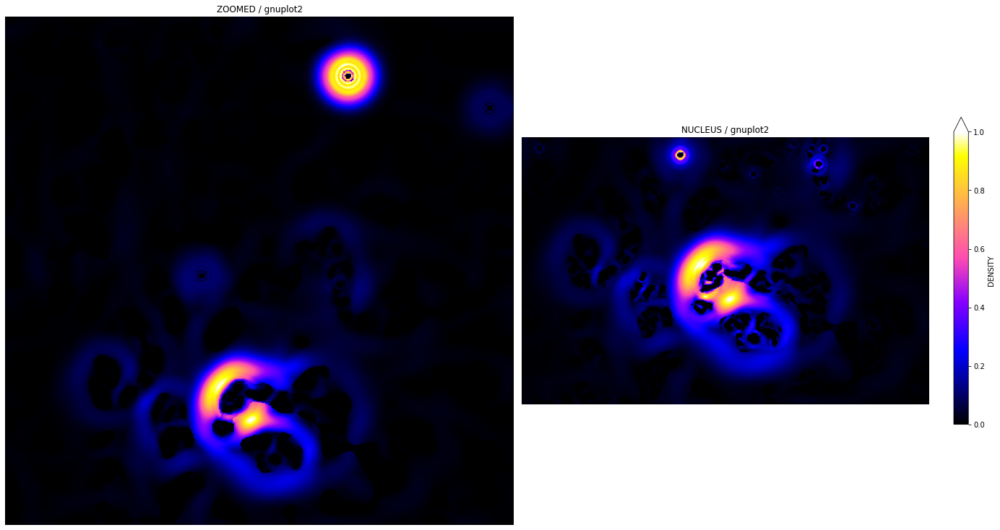

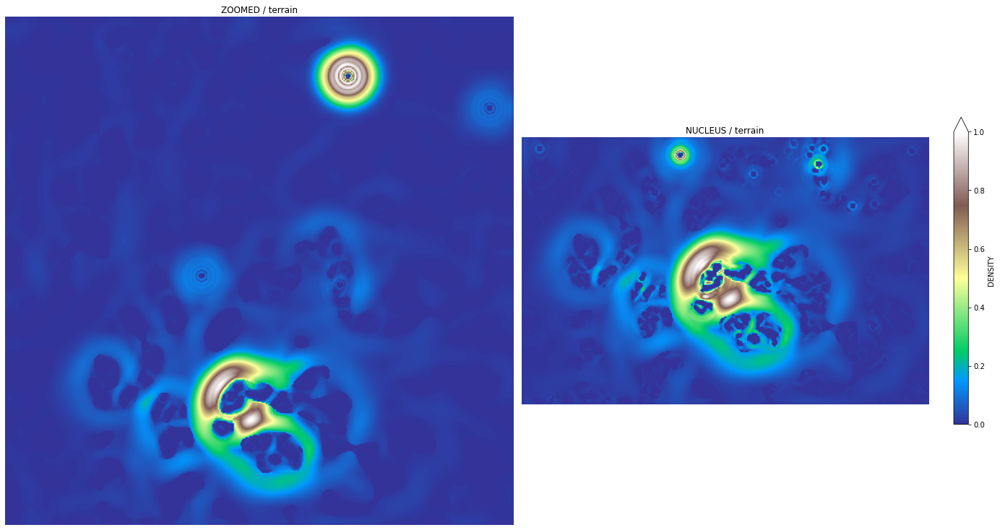

In [ ]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,2,figsize=(20,20))
    
    axis[0].imshow(M_ZOOMED_X3_SCALE_HST,cmap=x_spec)
    axis[0].set_title("ZOOMED" + " / "+ x_spec)
    axis[0].axis("off")
    
    DENSITY_FUNC = axis[1].imshow(M_NUCLEUS_SCALE_HST,cmap=x_spec)
    axis[1].set_title("NUCLEUS" + " / "+ x_spec)
    axis[1].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

#### Visualizing the Meijering with white ridges filter on the Nucleus of the image in normal and 3x zoom

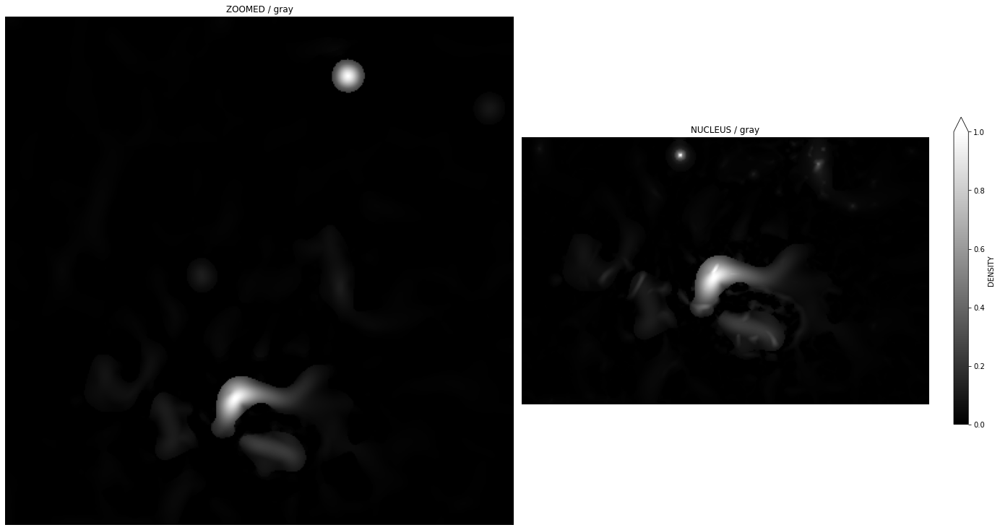

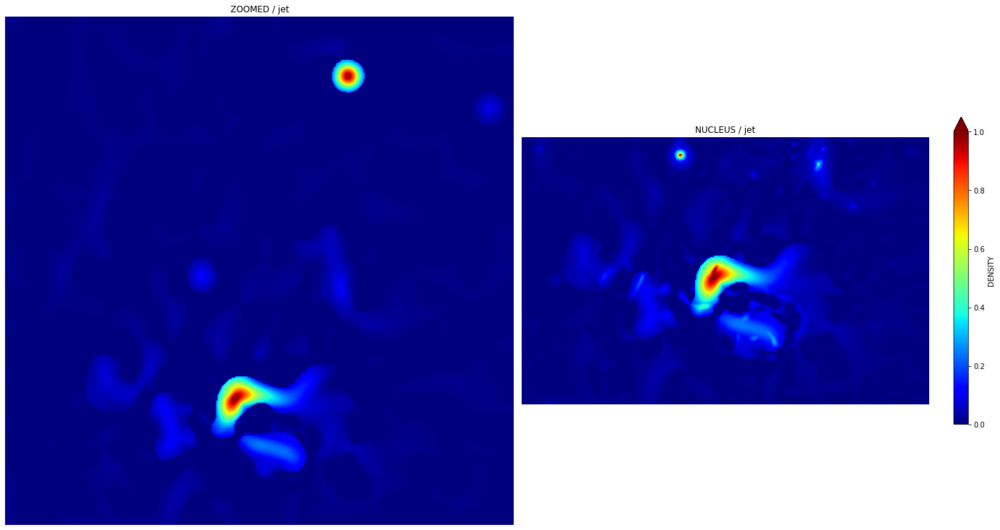

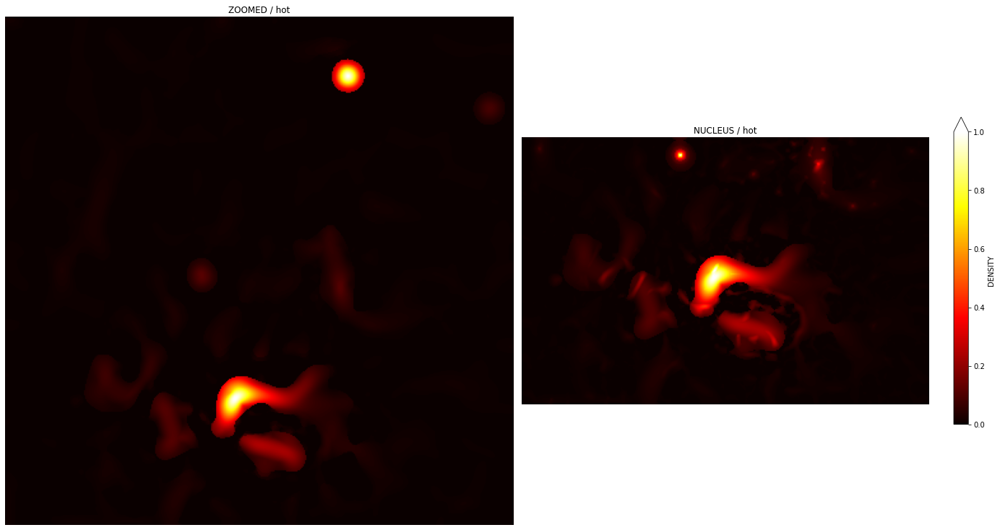

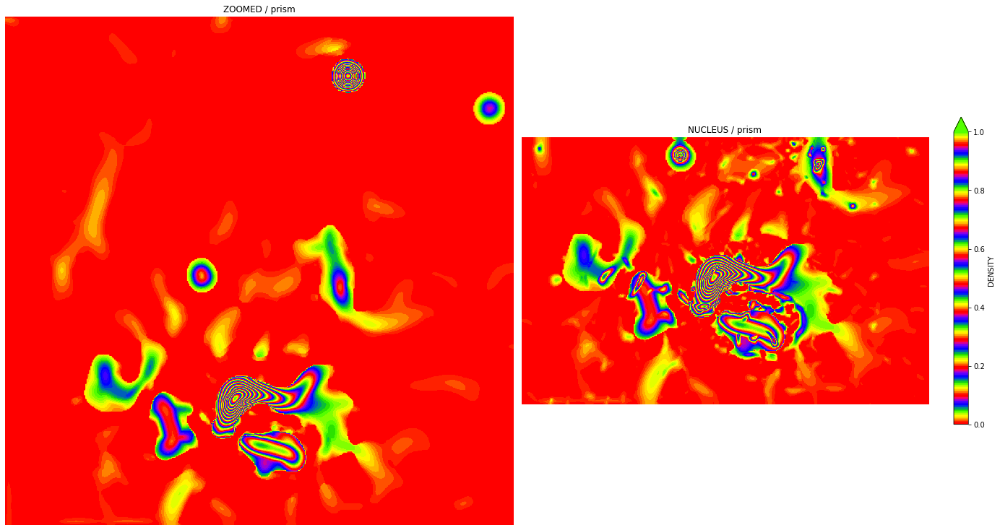

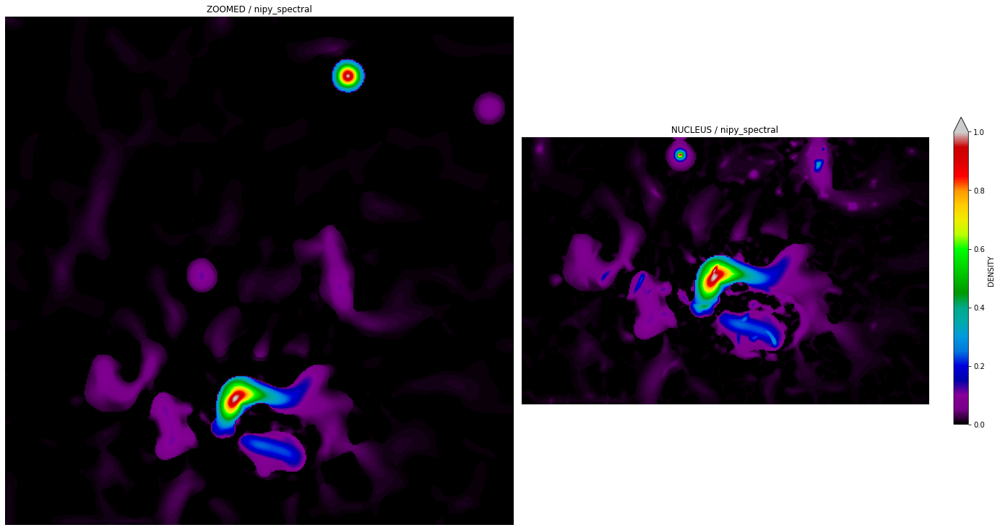

...

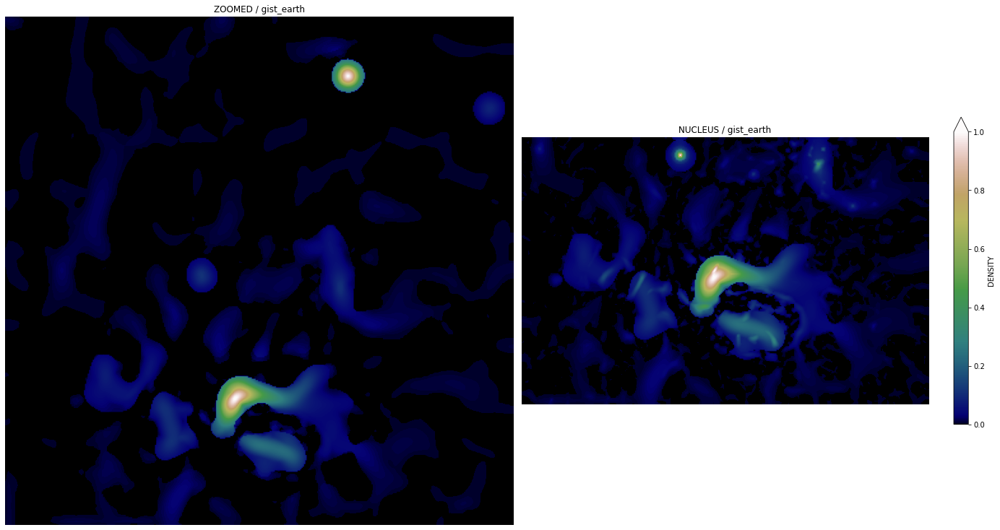

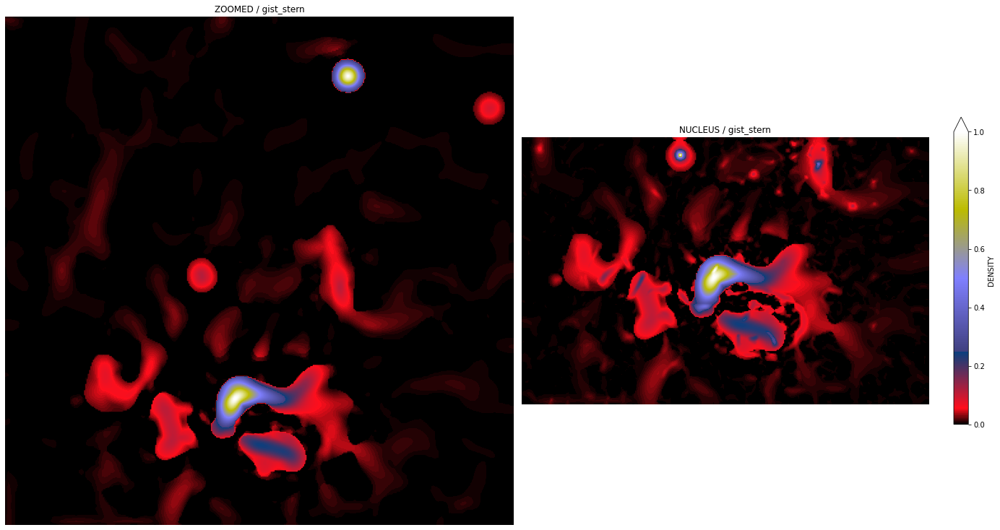

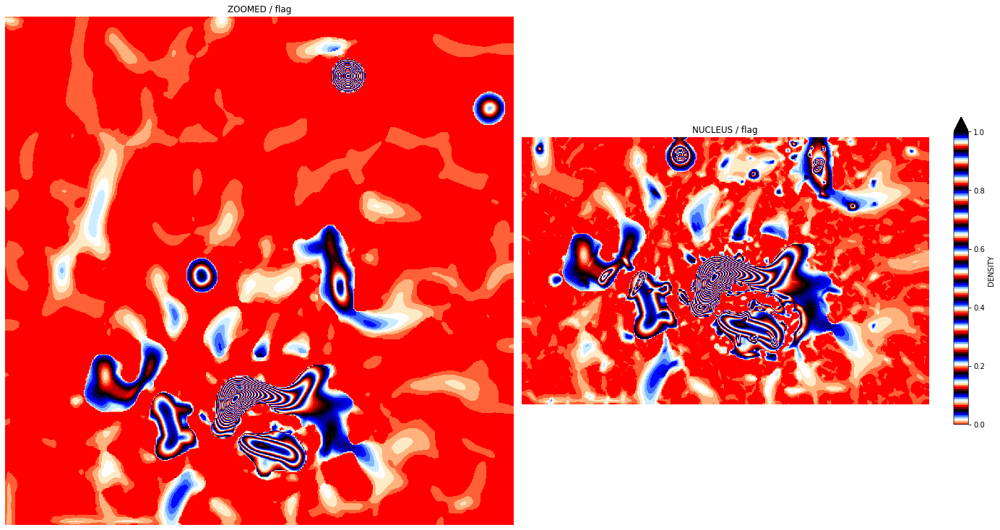

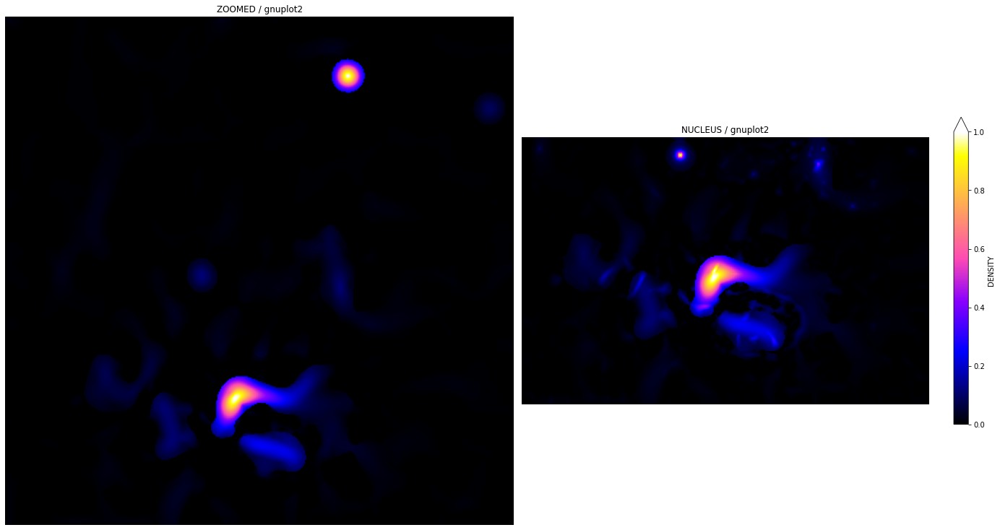

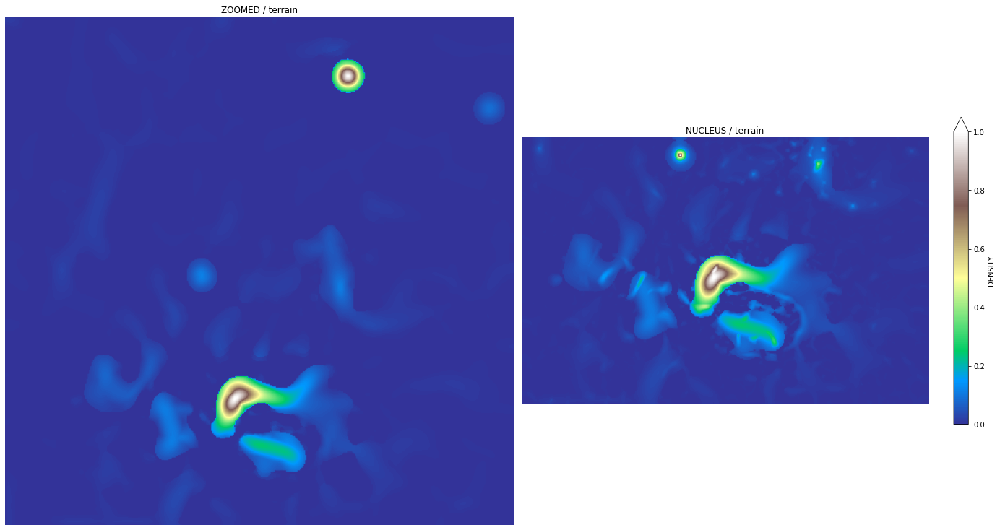

In [ ]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,2,figsize=(20,20))
    
    axis[0].imshow(BM_ZOOMED_X3_SCALE_HST,cmap=x_spec)
    axis[0].set_title("ZOOMED" + " / "+ x_spec)
    axis[0].axis("off")
    
    DENSITY_FUNC = axis[1].imshow(BM_NUCLEUS_SCALE_HST,cmap=x_spec)
    axis[1].set_title("NUCLEUS" + " / "+ x_spec)
    axis[1].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

#### Visualizing the Roberts' Cross Negative Diagonal filter on the Nucleus of the image in normal and 3x zoom

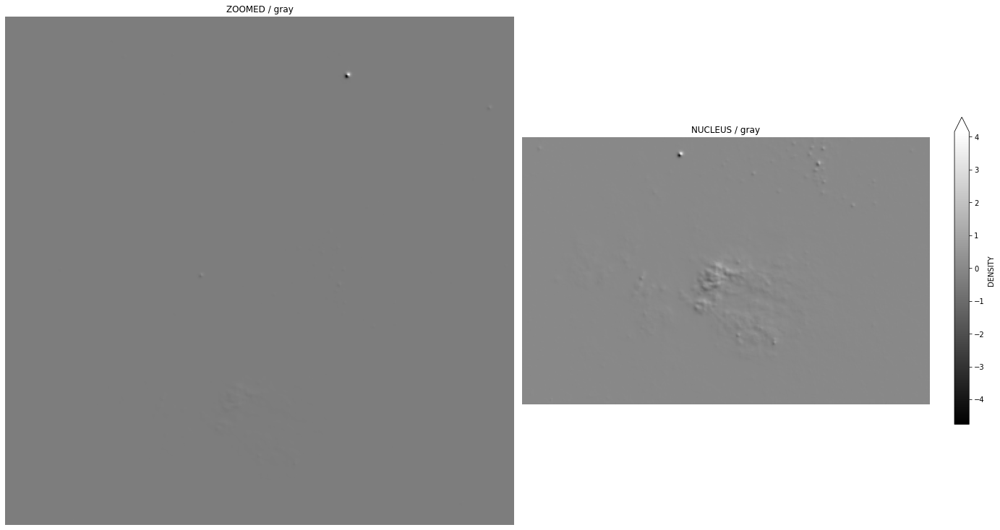

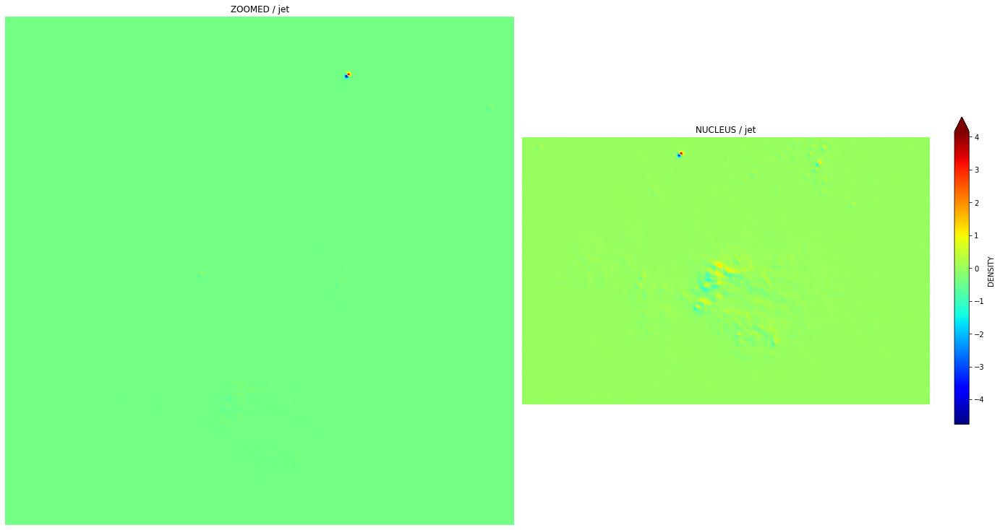

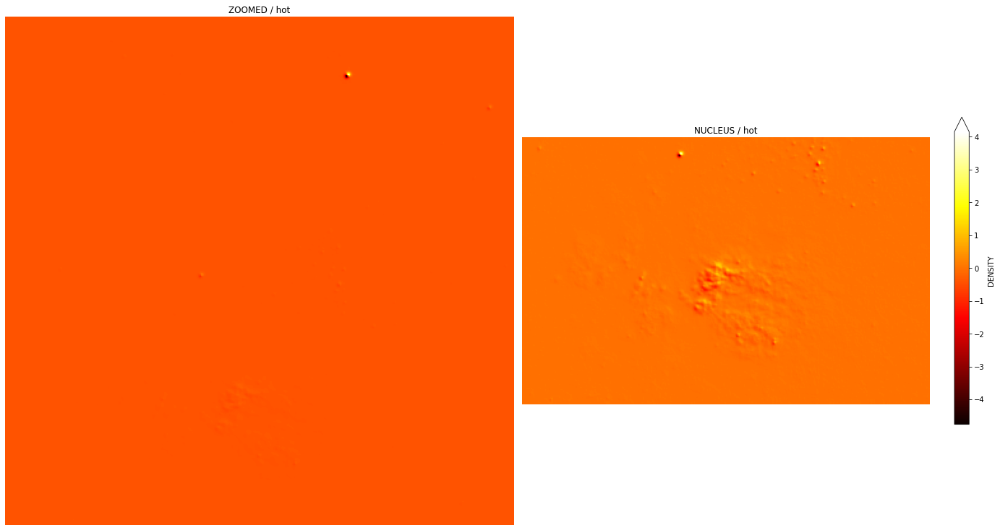

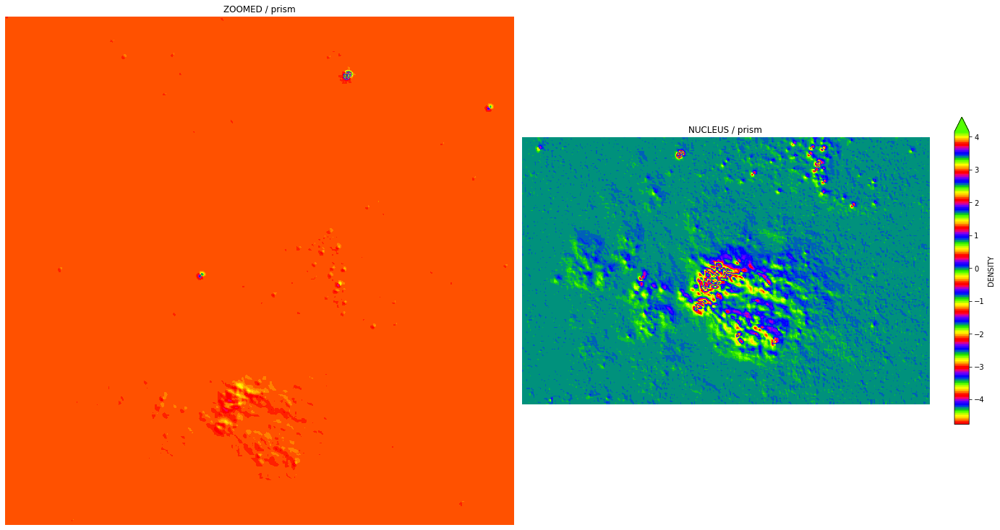

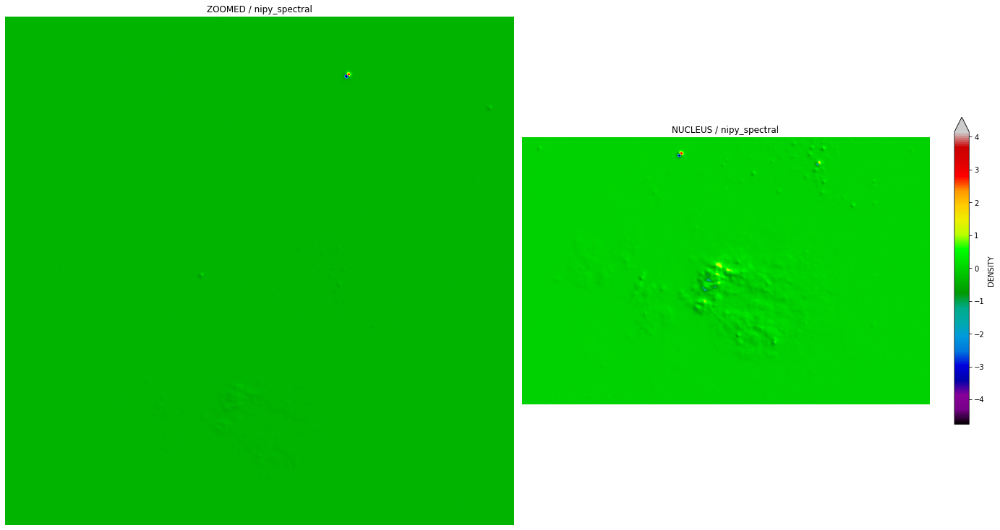

...

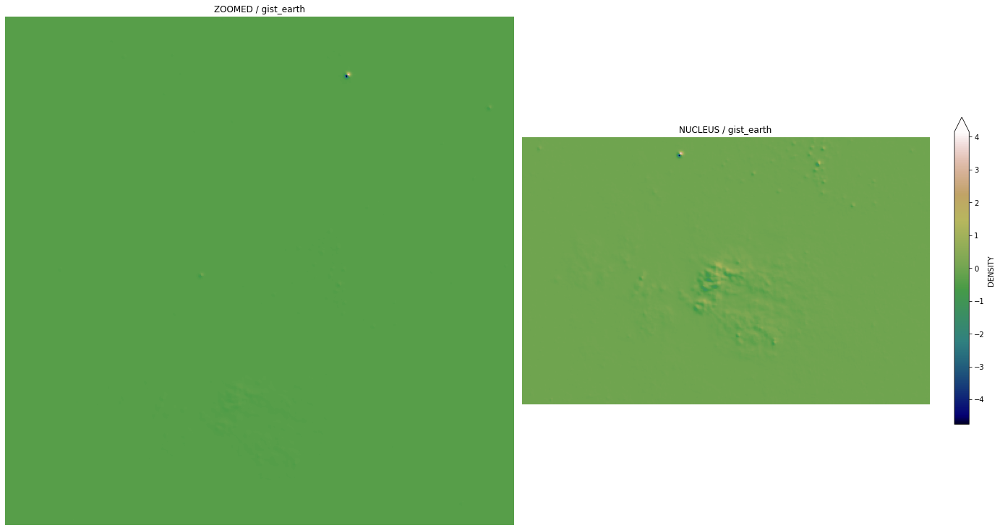

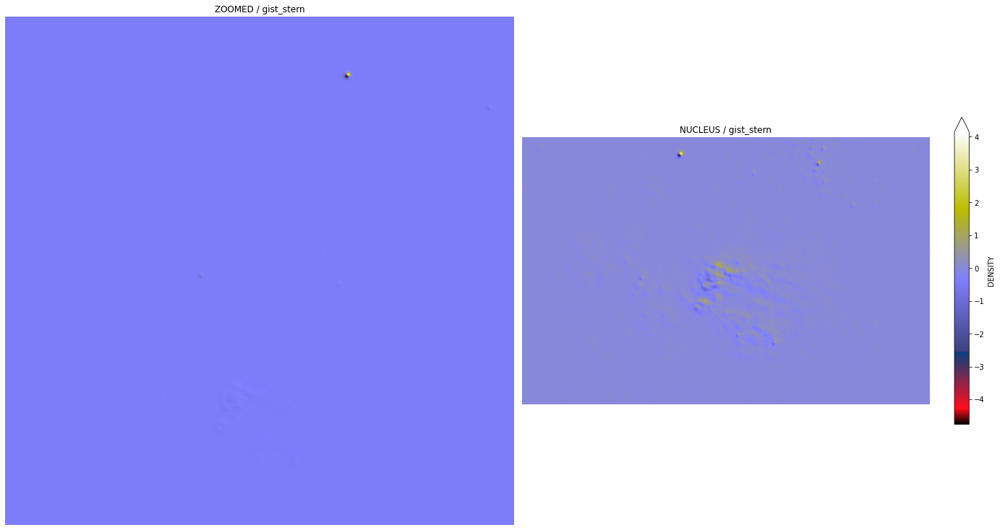

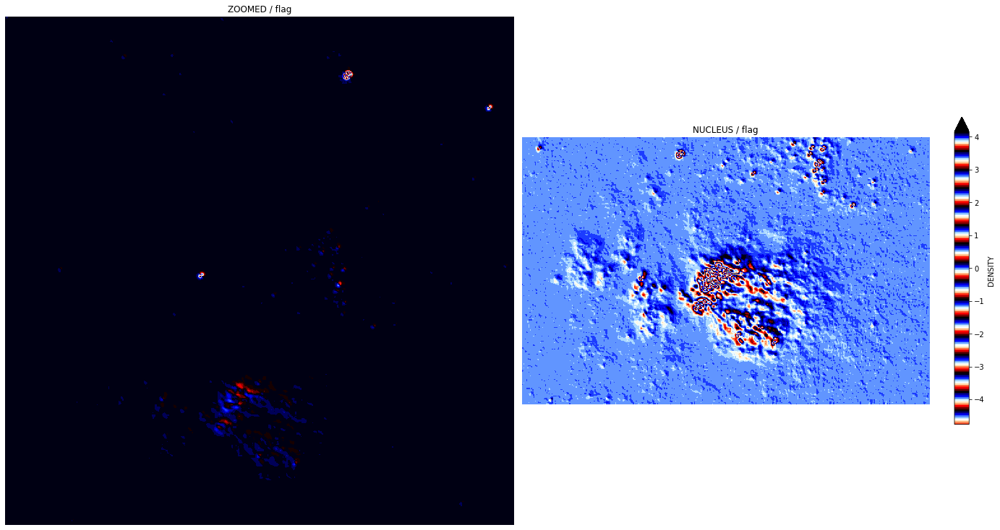

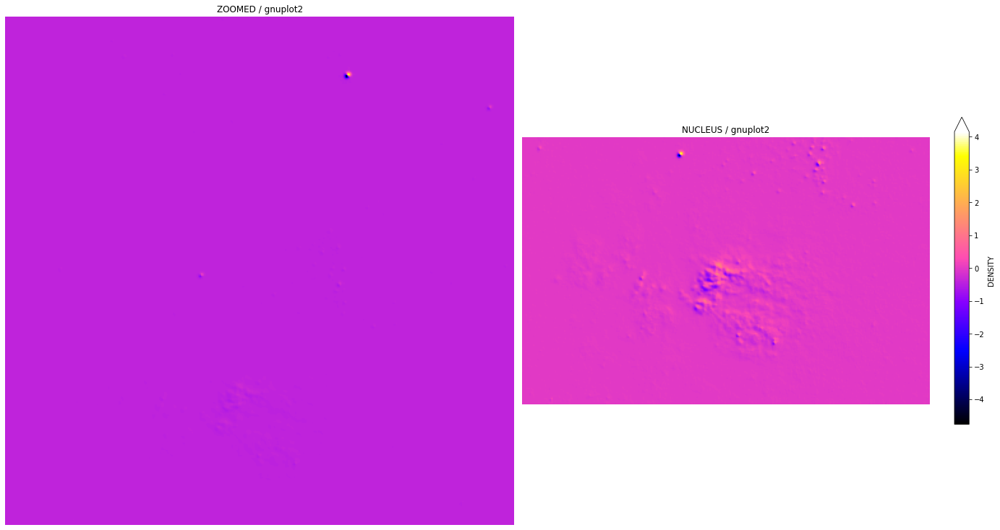

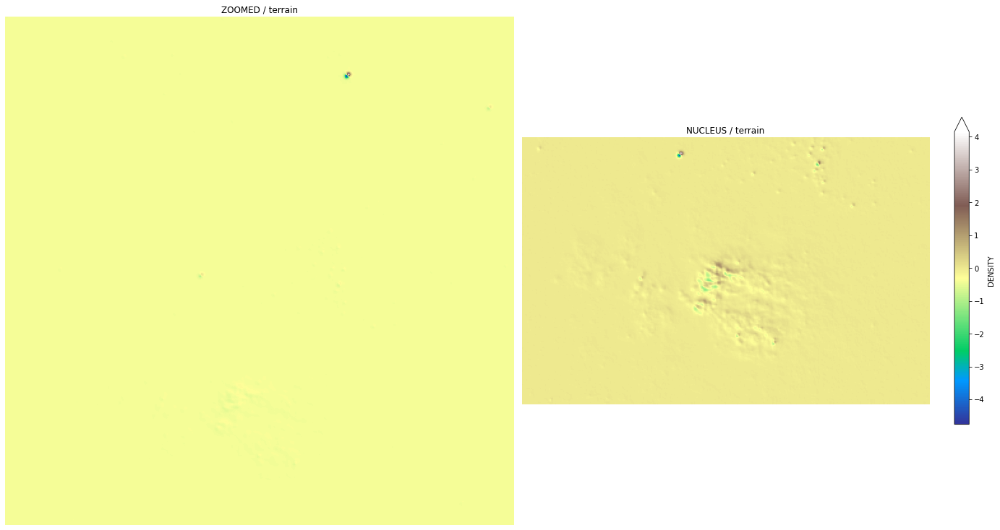

In [ ]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,2,figsize=(20,20))
    
    axis[0].imshow(R_ZOOMED_X3_SCALE_HST,cmap=x_spec)
    axis[0].set_title("ZOOMED" + " / "+ x_spec)
    axis[0].axis("off")
    
    DENSITY_FUNC = axis[1].imshow(R_NUCLEUS_SCALE_HST,cmap=x_spec)
    axis[1].set_title("NUCLEUS" + " / "+ x_spec)
    axis[1].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

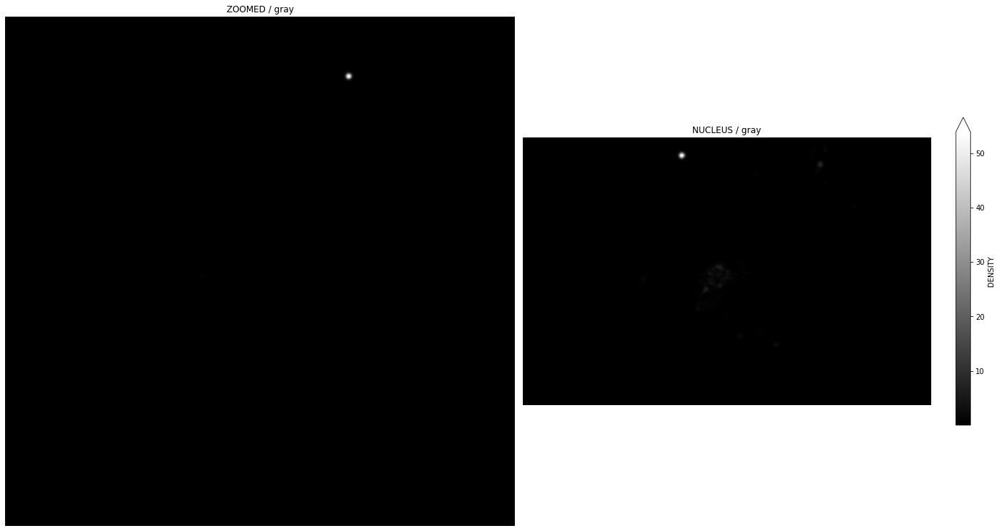

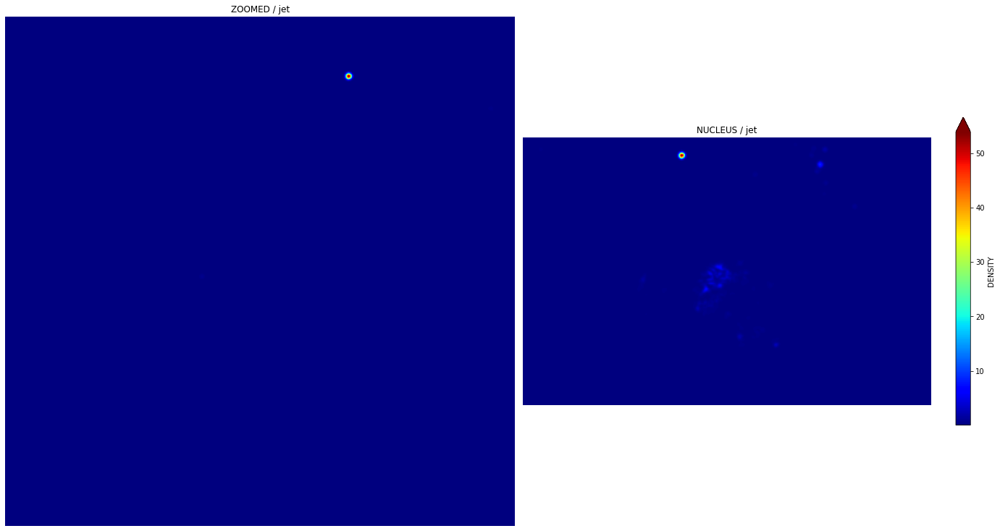

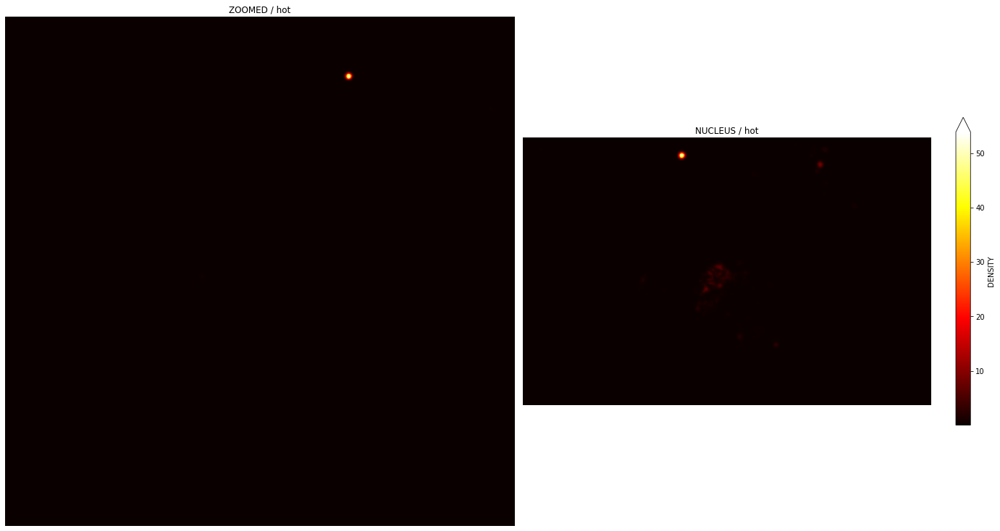

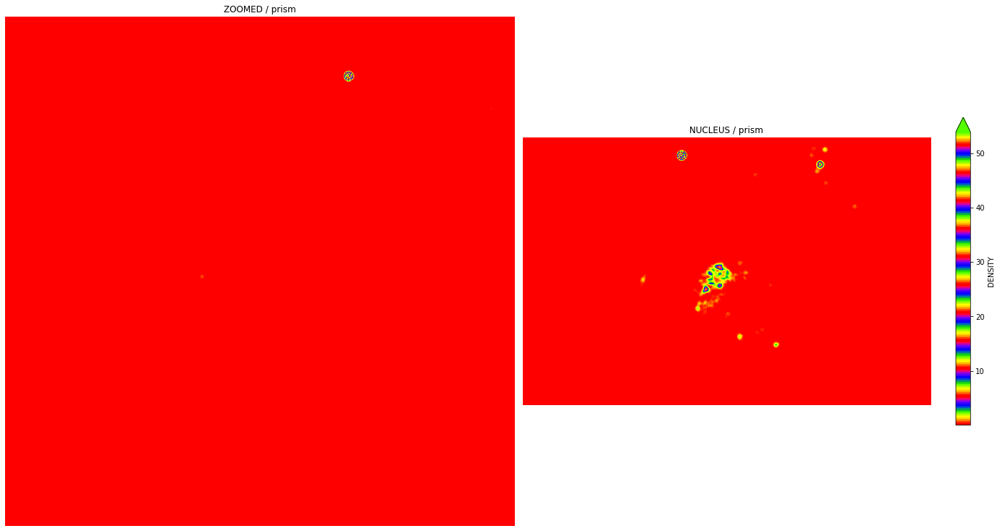

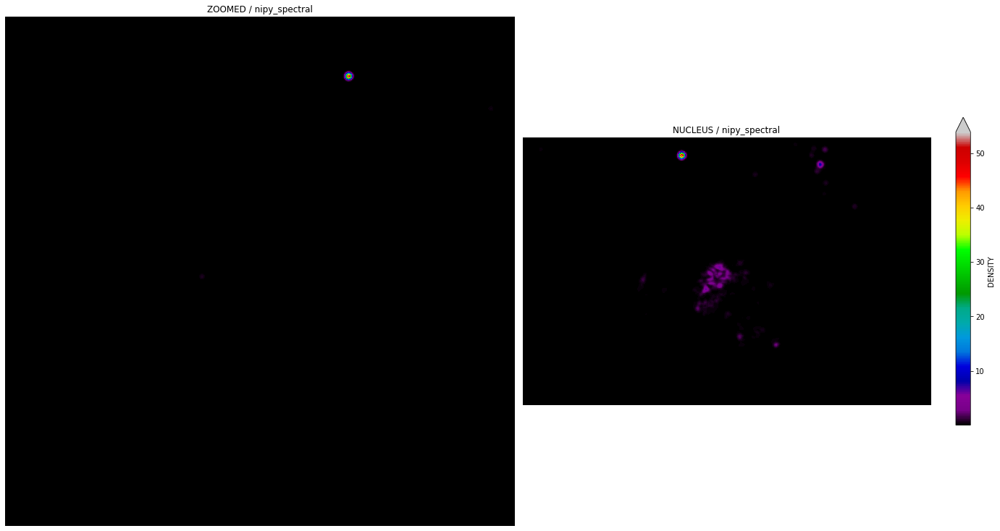

...

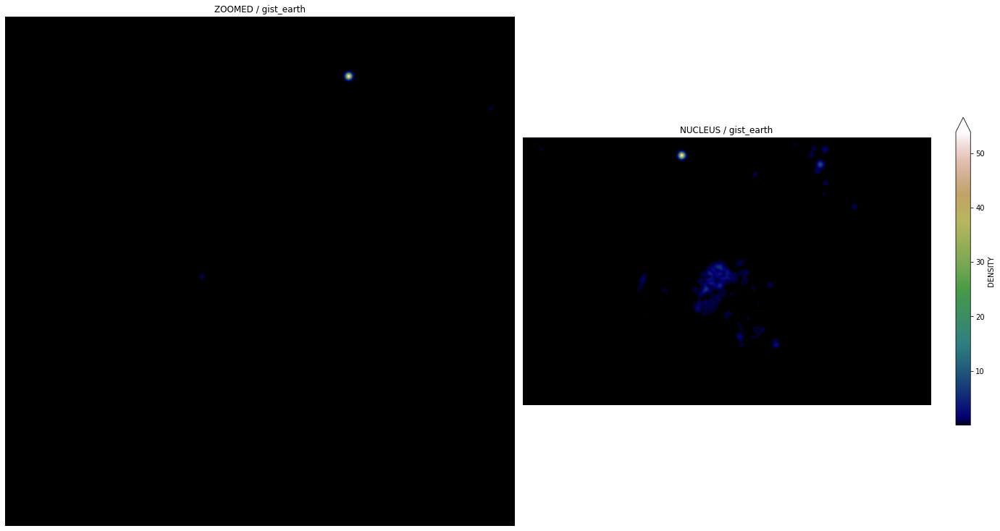

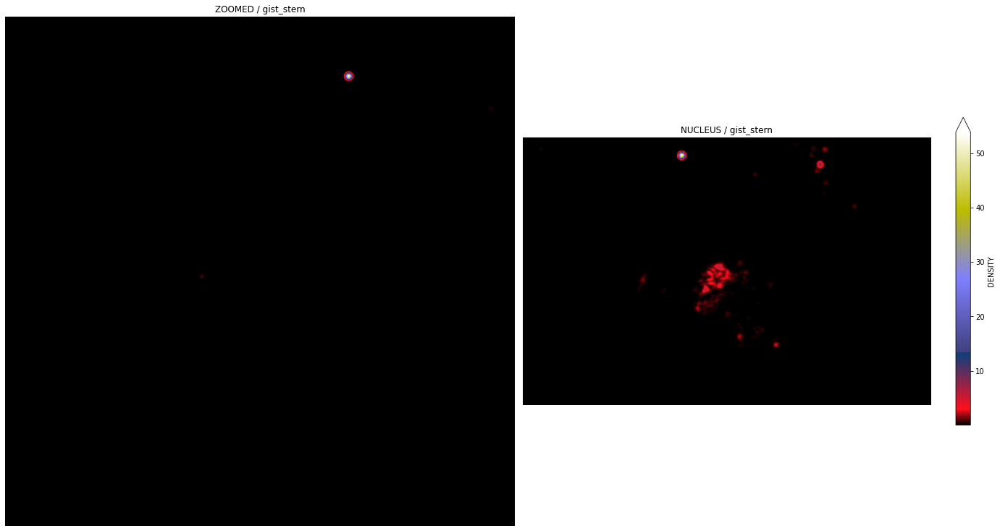

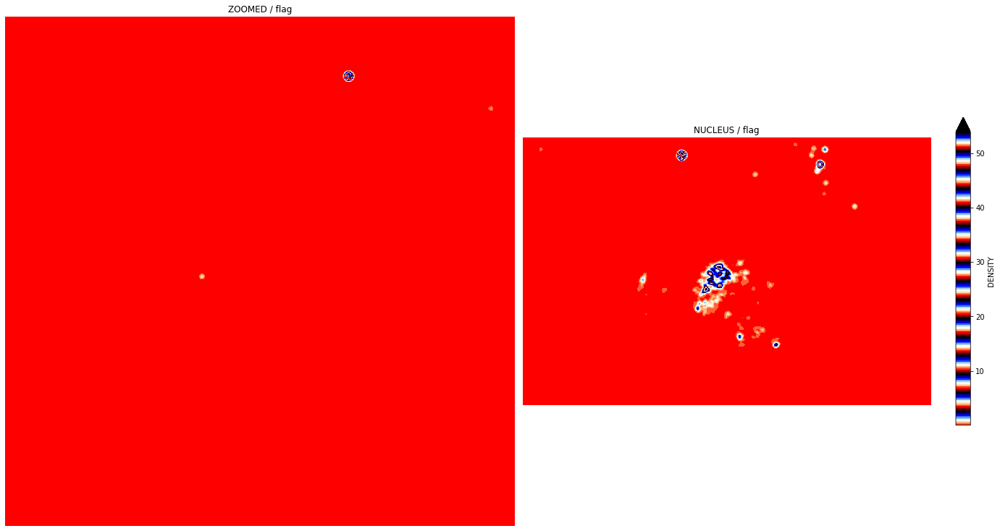

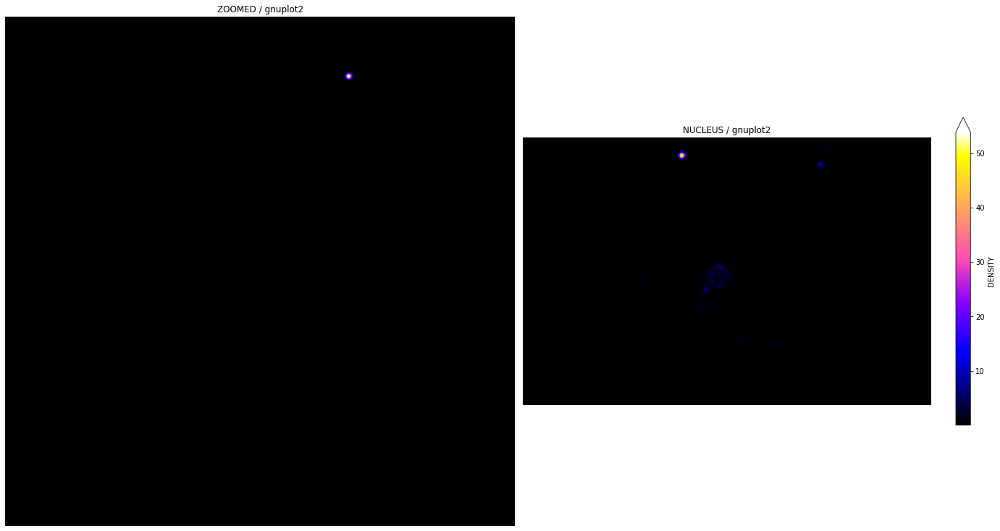

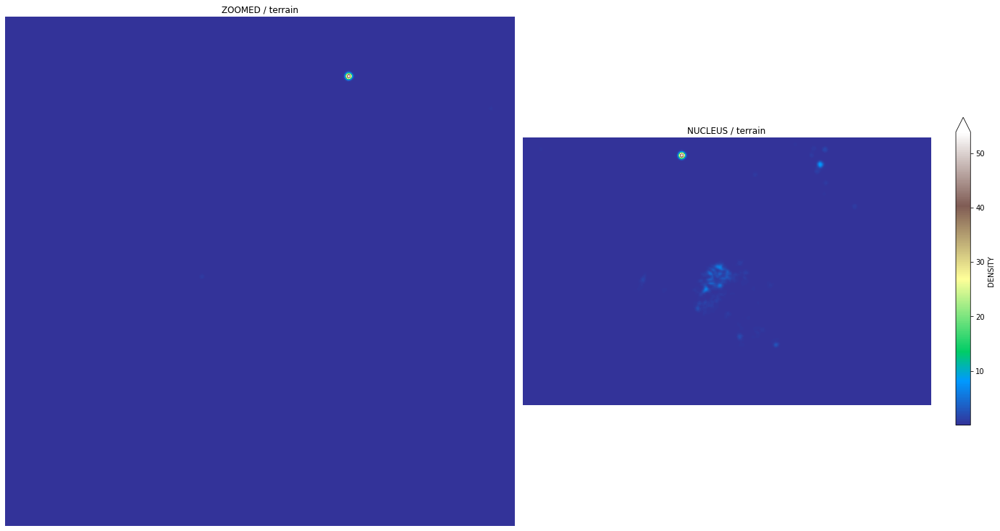

In [ ]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,2,figsize=(20,20))
    
    axis[0].imshow(FCF_ZOOMED_X3_SCALE_HST[0],cmap=x_spec)
    axis[0].set_title("ZOOMED" + " / "+ x_spec)
    axis[0].axis("off")
    
    DENSITY_FUNC = axis[1].imshow(FCF_NUCLEUS_SCALE_HST[0],cmap=x_spec)
    axis[1].set_title("NUCLEUS" + " / "+ x_spec)
    axis[1].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

#### Visualizing the Foerstner corner detection filter on the Nucleus of the image in normal and 3x zoom

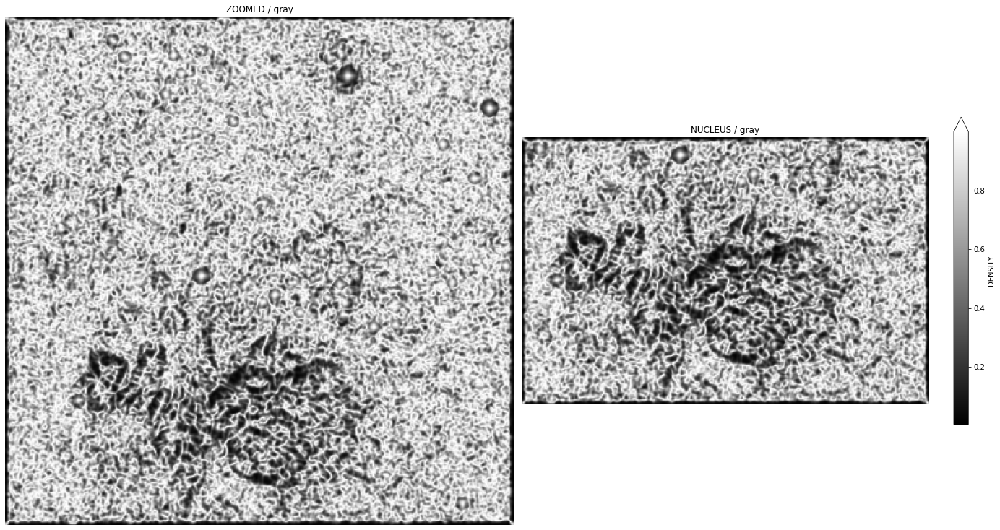

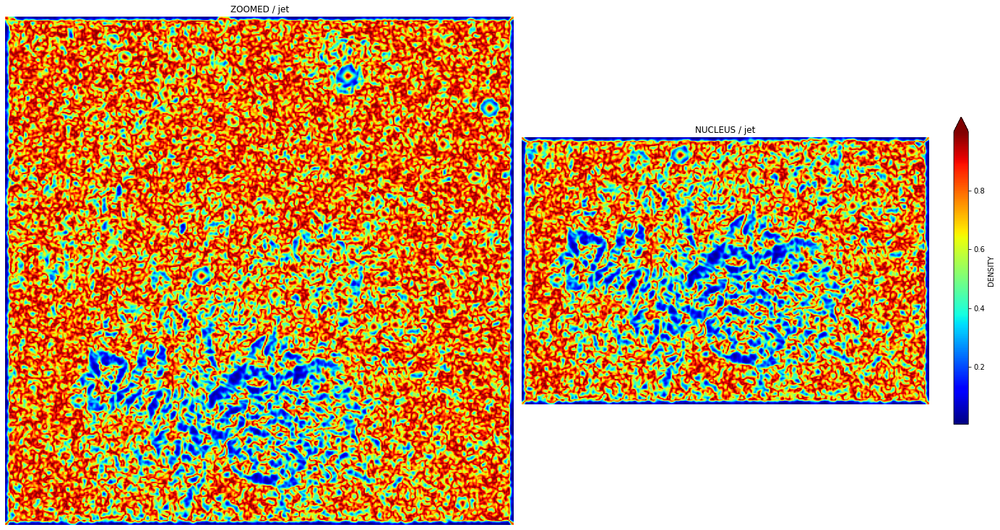

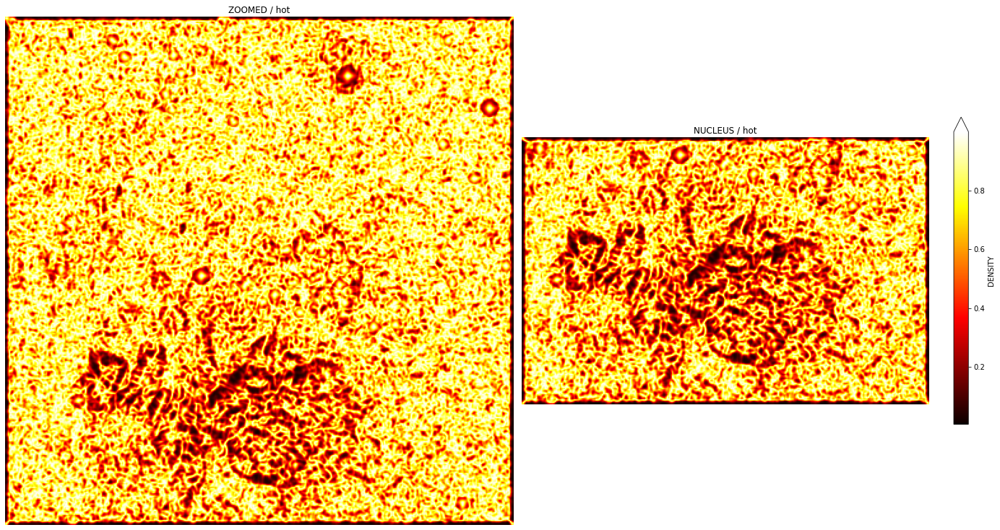

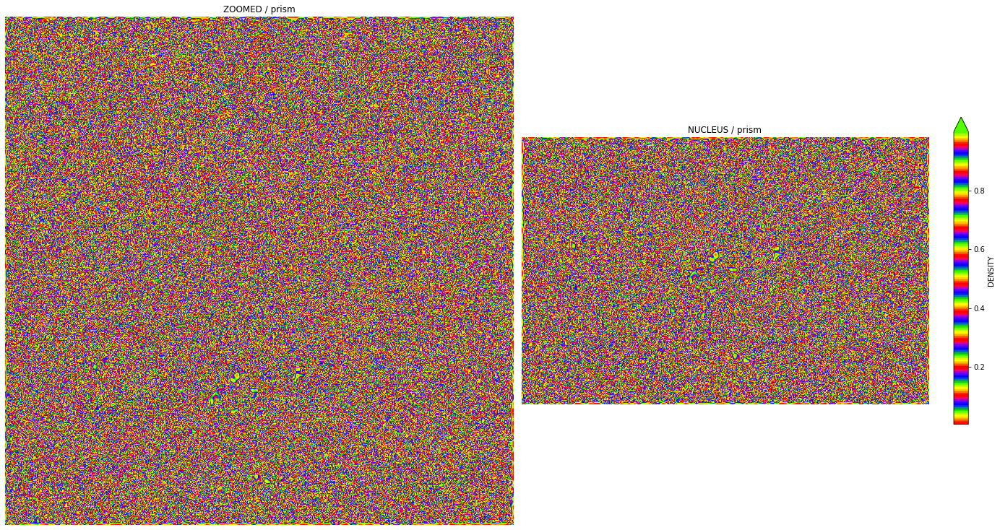

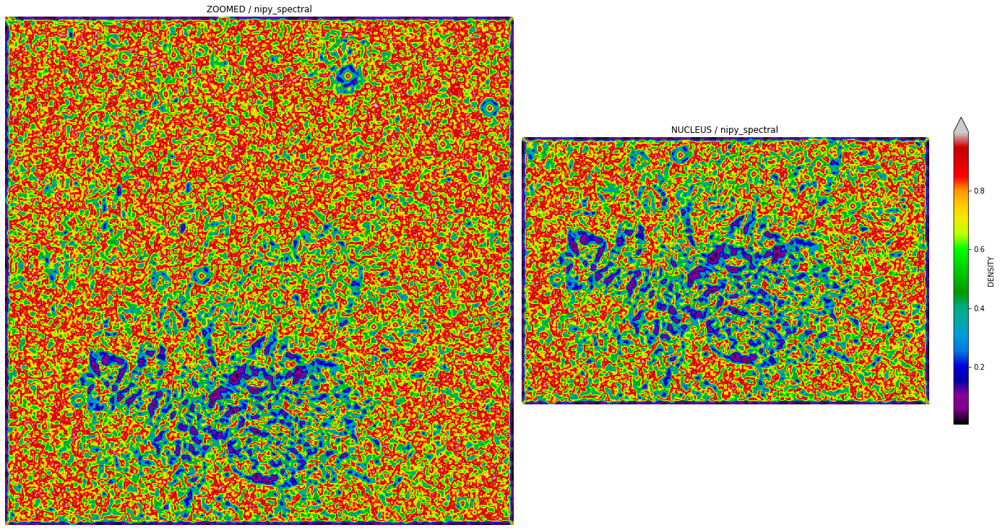

...

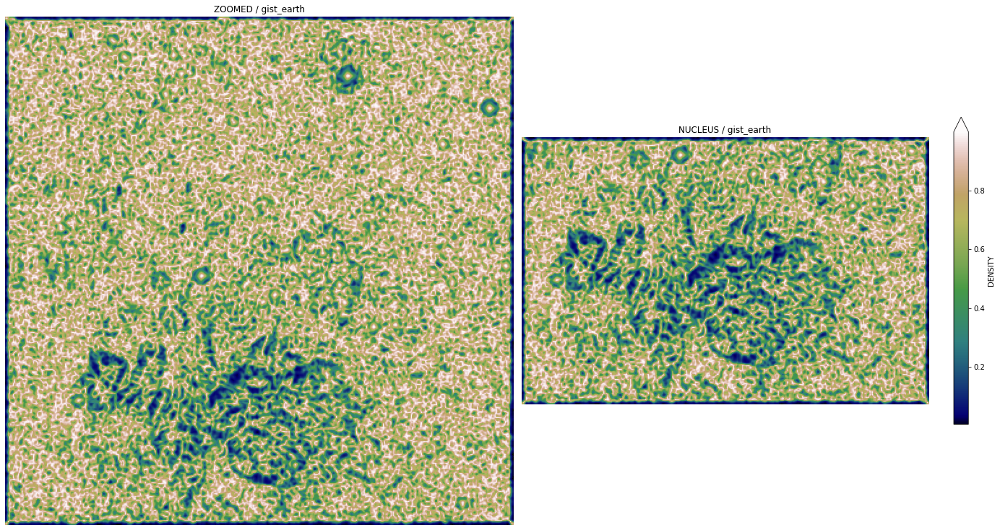

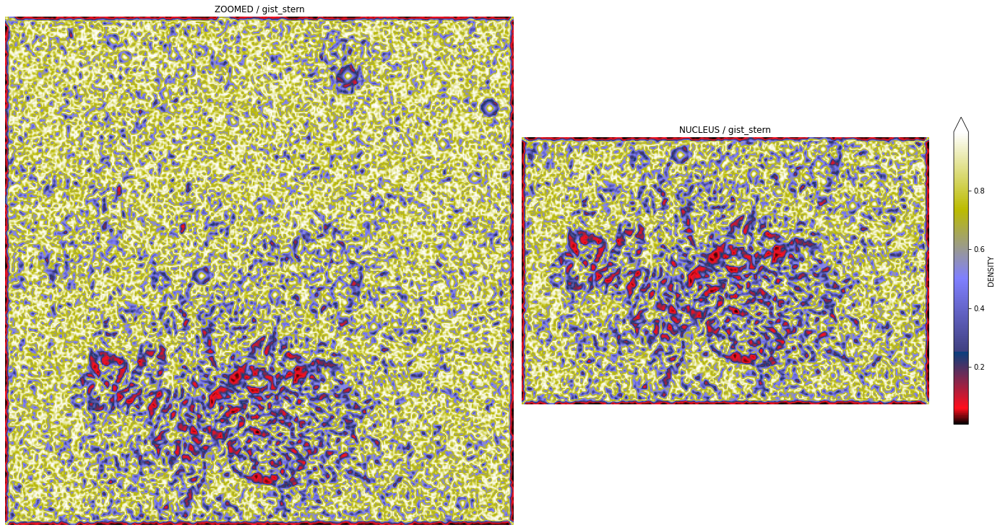

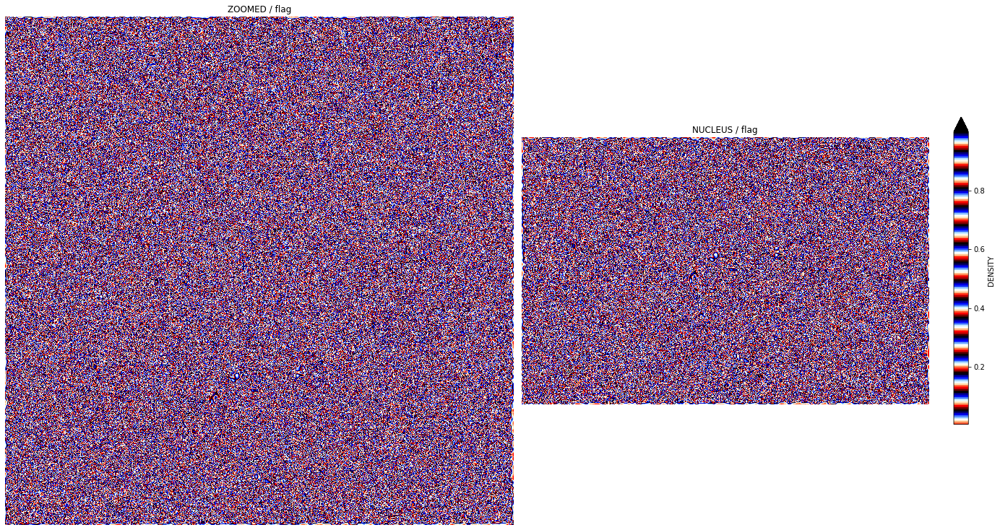

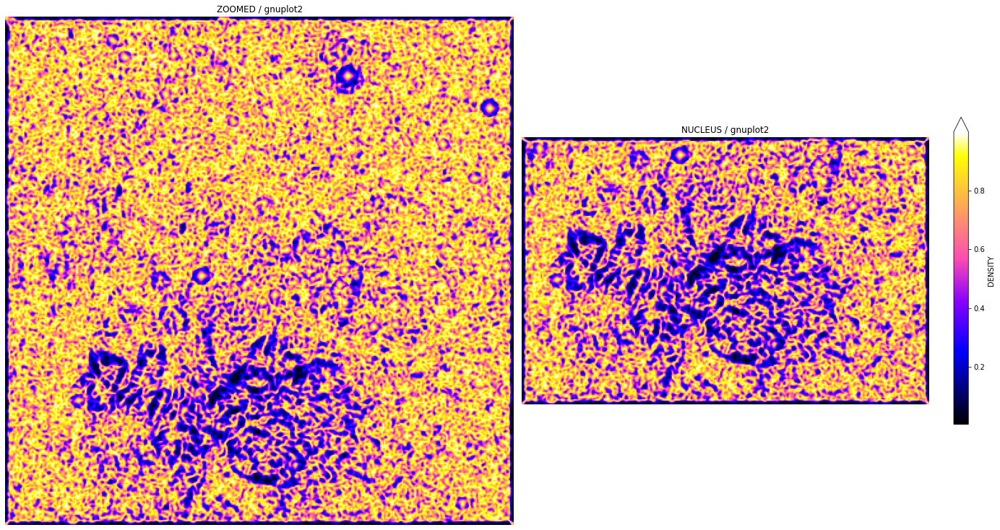

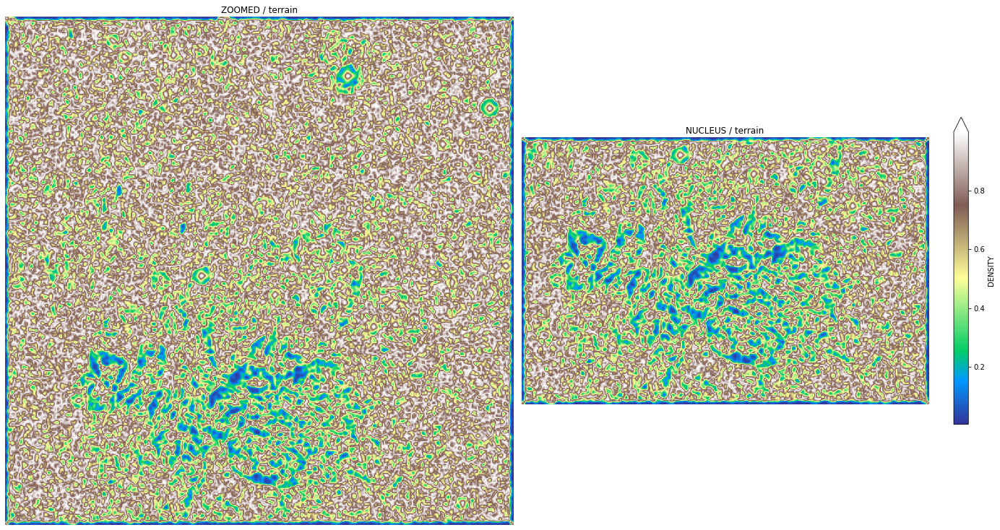

In [ ]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,2,figsize=(20,20))
    
    axis[0].imshow(FCF_ZOOMED_X3_SCALE_HST[1],cmap=x_spec)
    axis[0].set_title("ZOOMED" + " / "+ x_spec)
    axis[0].axis("off")
    
    DENSITY_FUNC = axis[1].imshow(FCF_NUCLEUS_SCALE_HST[1],cmap=x_spec)
    axis[1].set_title("NUCLEUS" + " / "+ x_spec)
    axis[1].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

#### Speckle imaging
Speckle imaging describes a range of high-resolution astronomical imaging techniques based on the analysis of large numbers of short exposures that freeze the variation of atmospheric turbulence. They can be divided into the shift-and-add ("image stacking") method and the speckle interferometry methods. These techniques can dramatically increase the resolution of ground-based telescopes, but are limited to bright targets.

##### Image Stacking
The shift-and-add method aka "image-stacking" method is a form of speckle imaging commonly used for obtaining high quality images from a number of short exposures with varying image shifts. It has been used in astronomy for several decades, and is the basis for the image stabilisation feature on some cameras. The short exposure images are aligned by using the brightest speckle and averaged to give a single output image. 

Following are a few simple tricks to brighten, darken the whole or particular features of the images using shift-and-add method.

#### Brightening an image using shift-and-add method

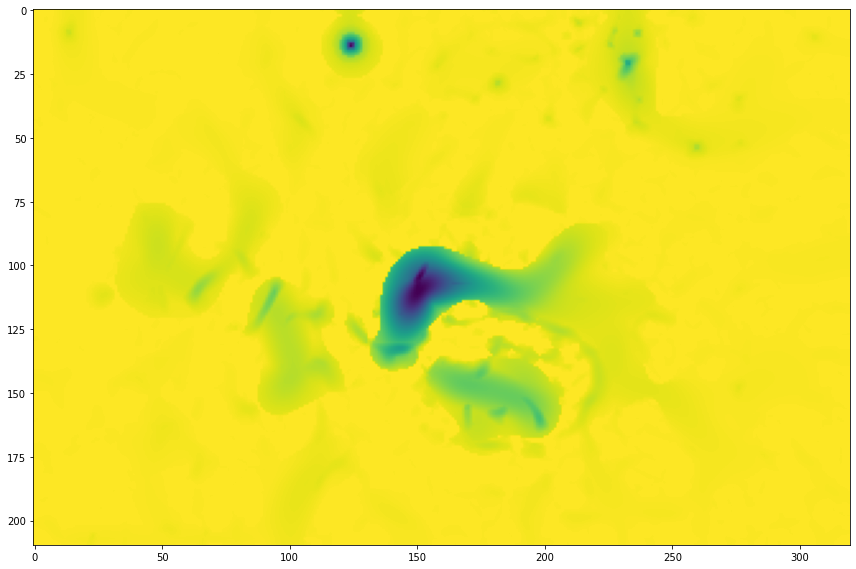

In [ ]:
figure = plt.figure(figsize=(12,12))
Picking_Image = BM_NUCLEUS_SCALE_HST
Bright_IMG = Picking_Image + (np.ones(Picking_Image.shape) - Picking_Image) * 1000
plt.imshow(Bright_IMG)
plt.tight_layout()
plt.show()

#### Darkening an image using shift-and-add method

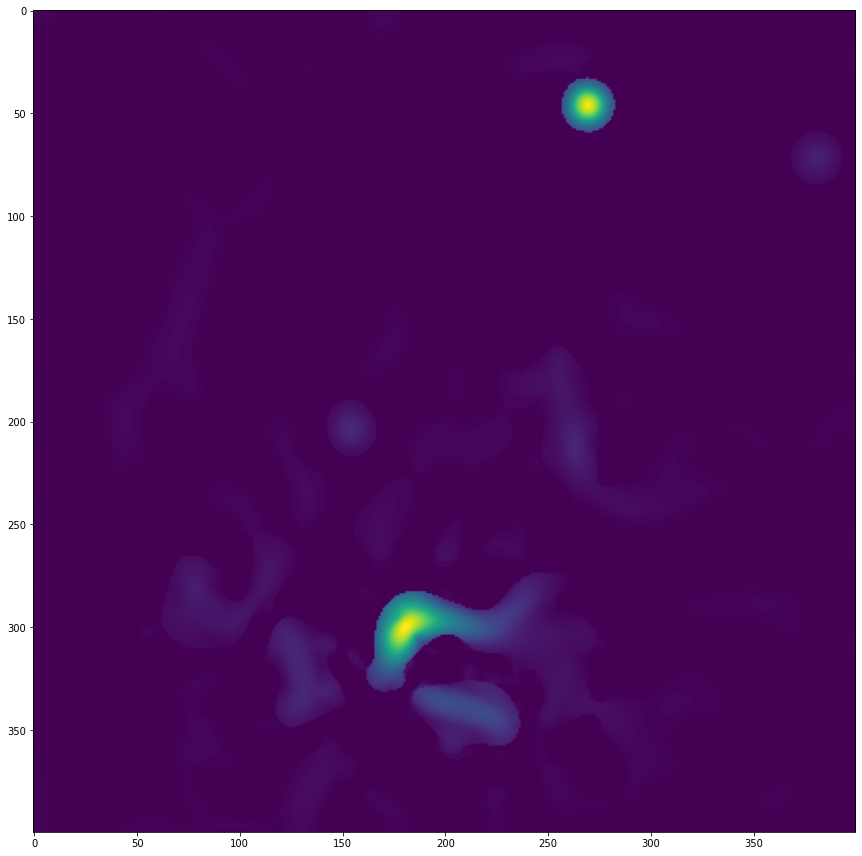

In [ ]:
figure = plt.figure(figsize=(12,12))
Picking_Image = BM_ZOOMED_X3_SCALE_HST
Dark_IMG = Picking_Image + (np.ones(Picking_Image.shape) - Picking_Image) * 0.05
plt.imshow(Dark_IMG)
plt.tight_layout()
plt.show()

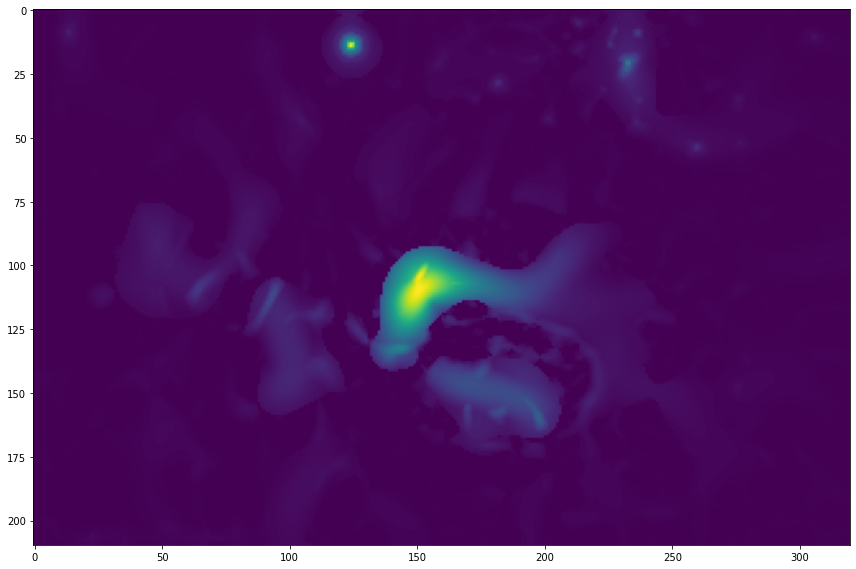

In [ ]:
figure = plt.figure(figsize=(12,12))
Picking_Image = BM_NUCLEUS_SCALE_HST
Dark_IMG = Picking_Image + (np.ones(Picking_Image.shape) - Picking_Image) * 0.05
plt.imshow(Dark_IMG)
plt.tight_layout()
plt.show()

#### Highlighting a feature in an image using shift-and-add method, here several shifted images of varying degress are stacked together.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


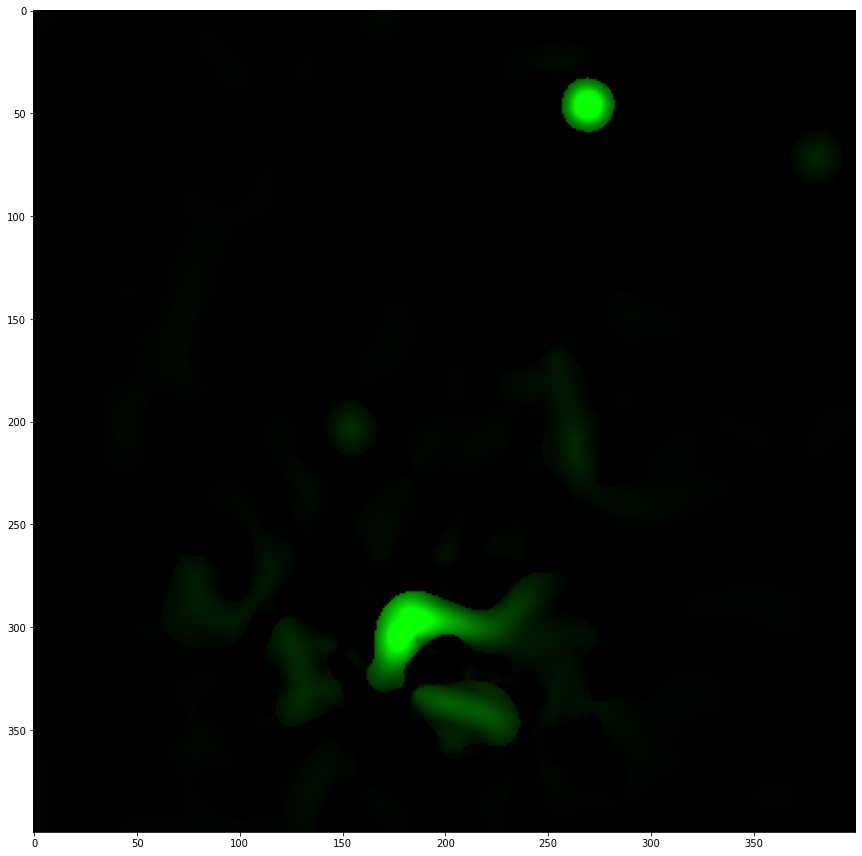

In [ ]:
figure = plt.figure(figsize=(12,12))
Picking_Image = BM_ZOOMED_X3_SCALE_HST
Spes_Color_IMG = np.dstack((Picking_Image*0.05, Picking_Image*1.5, Picking_Image*0.02))
plt.imshow(Spes_Color_IMG)
plt.tight_layout()
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


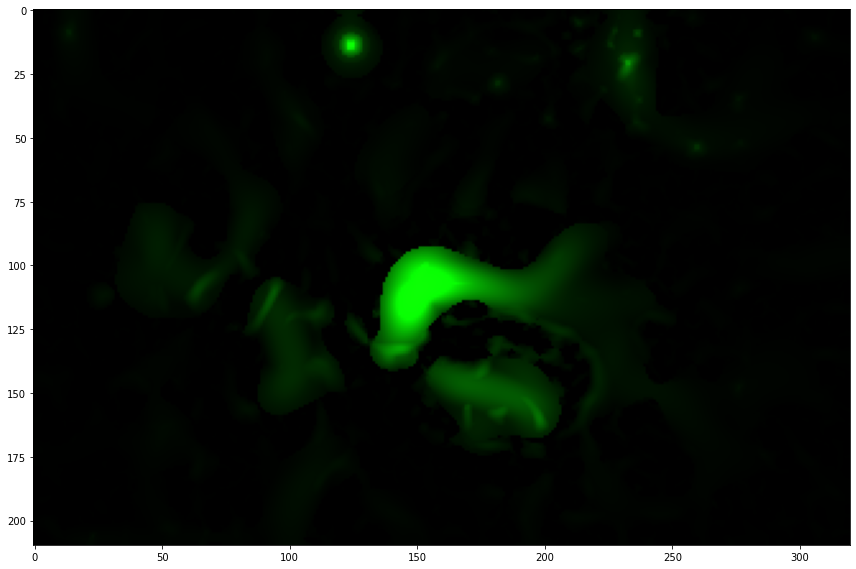

In [ ]:
figure = plt.figure(figsize=(12,12))
Picking_Image = BM_NUCLEUS_SCALE_HST
Spes_Color_IMG = np.dstack((Picking_Image*0.05, Picking_Image*1.5, Picking_Image*0.02))
plt.imshow(Spes_Color_IMG)
plt.tight_layout()
plt.show()

## Conclusion
A quick wrap up of this notebook,

* EDA on specific features of Astronomical images using Slicing, different types of Edge and Corner detection filters, and spectral maps. 
* Image stacking aka Shift-and-add method to brighten, darken or improve overall resolution of an image by shifting the pixels of an image by certain degrees and stacking/adding these images together to obtain the desired result.


## Thanks for reading so far! Feel free to fork this notebook and add your own inputs and experiment! Happy EDA!